In [1]:
import os
import shutil

In [2]:
# read data from the folder 
root_path = "vehicle-detection/"
# checking directory list in the root path 
dir_list = os.listdir(root_path)
dir_list

['classes.txt',
 'desktop.ini',
 'model',
 'test',
 'train',
 'train.txt',
 'vehicle-test',
 'vehicle-train']

This dataset contains only train folder, therefore, we need to create a subset of this dataset for test purpose.

In [3]:
data_train_path = "vehicle-detection/train/"
train_dir_list = os.listdir(data_train_path)
print(train_dir_list)

['images', 'labels', 'labels.npy']


In [8]:
train_images_path = data_train_path + "images/"
train_labels_path = data_train_path + "labels/"

print(f"Total training images: {len(os.listdir(train_images_path))}")
print(f"Total training labels: {len(os.listdir(train_labels_path))}")

Total training images: 8218
Total training labels: 8218


We have total 8218 images and 8218 labels in total. Now we will create a subset of this dataset for the test purpose.

In [15]:
# CHECKING ALL IMAGES HAVE THEIR CORRESPONDING LABELS
train_img = os.listdir(train_images_path)
train_labels = os.listdir(train_labels_path)
labels_list = []
for label in train_labels:
    label_text = label.split('.')
    label_name = label_text[0]
    labels_list.append(label_name)

print(f"Total labels: {len(labels_list)}")
    
for file in train_img:
    file_text = file.split('.')
    img_name = file_text[0]
    if img_name in labels_list:
        # print(f"{file}=>> Matched")
        pass
    else:
        print(f"{file}=>> Did not match -_-")


Total labels: 8218


In [37]:
# getting the labels
train_labels = os.listdir(train_labels_path)
labels_list = []
for label_path in train_labels:
    # print(label_path)
    with open(os.path.join(train_labels_path+label_path)) as f:
        lines = [line.strip() for line in f.readlines()]
        for line in lines:
            # print(line)
            s = line.split(' ')
            labels_list.append(int(s[0]))

print(f"Unique labels in the dataset: {list(set(labels_list))}")

Unique labels in the dataset: [0, 1, 2, 3, 4, 5, 6, 7]


In [38]:
# List of labels
labels = [
    "auto",
    "bus",
    "car",
    "lcv",
    "motorcycle",
    "multiaxle",
    "tractor",
    "truck"
]

# Create label-to-index and index-to-label dictionaries
label_to_idx = {label: idx for idx, label in enumerate(labels)}
idx_to_label = {idx: label for idx, label in enumerate(labels)}

# Display the dictionaries
print("Label to Index Mapping:")
print(label_to_idx)

print("\nIndex to Label Mapping:")
print(idx_to_label)


Label to Index Mapping:
{'auto': 0, 'bus': 1, 'car': 2, 'lcv': 3, 'motorcycle': 4, 'multiaxle': 5, 'tractor': 6, 'truck': 7}

Index to Label Mapping:
{0: 'auto', 1: 'bus', 2: 'car', 3: 'lcv', 4: 'motorcycle', 5: 'multiaxle', 6: 'tractor', 7: 'truck'}


In [51]:
# creating test directory
test_path = root_path + "vehicle-test/"
os.makedirs(test_path, exist_ok=True)

In [17]:
# defining the test subset percentage
test_percentage = 15
num_test = (test_percentage * len(os.listdir(train_images_path))) // 100 
print(f"The number of total test sample will be: {num_test}")

The number of total test sample will be: 1232


In [52]:
f_train_path = root_path + "vehicle-train/"
os.makedirs(f_train_path, exist_ok=True)

In [54]:
# total training sample will be 
num_train = len(os.listdir(train_images_path)) - num_test
print(f"Total train samples will be: {num_train}")

Total train samples will be: 6986


Now, we will walk through the dataset to get insights of train data and their labels

In [4]:
from PIL import Image
import cv2
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
import cv2

In [42]:
d_img_name = train_img[5477]
d_img_path = train_images_path + d_img_name
print(f"The image path: {d_img_path}")

The image path: vehicle-detection/train/images/Highway_923_2020-07-30_jpg.rf.fd80617462ad15e662faf435bc9d5574.jpg


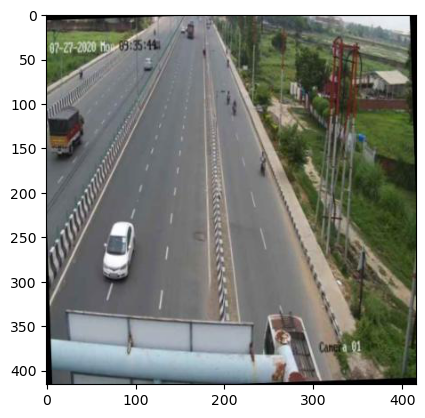

In [43]:
img = Image.open(d_img_path)
plt.imshow(img)
plt.show()

In [44]:
# getting image height, width, and channel
cv_img = cv2.imread(d_img_path)
img_height, img_width, c = cv_img.shape
print(f"Height of the image: {img_height}")
print(f"Width of the image: {img_width}")
print(f"Image channels: {c}")

Height of the image: 416
Width of the image: 416
Image channels: 3


In [45]:
# now we will get the corrseponding label of this image 
d_img_split = d_img_name.split('.')
d_img_id = d_img_split[0]

d_label = ''

for label in os.listdir(train_labels_path):
    label_text = label.split('.')
    if label_text[0] == d_img_id:
       d_label = label

print(f"The demo image file: {d_img_name}")
print(f"The label of that demo image is: {d_label}")

The demo image file: Highway_923_2020-07-30_jpg.rf.fd80617462ad15e662faf435bc9d5574.jpg
The label of that demo image is: Highway_923_2020-07-30_jpg.rf.fd80617462ad15e662faf435bc9d5574.txt


In [46]:
# reading the bounding class labels and boxes
label_path = train_labels_path + d_label 

with open(os.path.join(label_path)) as f:
    lines = [line.strip() for line in f.readlines()]
print(lines)

['2 0.198317 0.639423 0.093750 0.163462', '7 0.058894 0.320913 0.112981 0.156250', '4 0.590144 0.400240 0.040865 0.074519', '4 0.512019 0.254808 0.028846 0.048077', '4 0.493990 0.227163 0.026442 0.040865', '2 0.276442 0.132212 0.043269 0.043269']


We can see that, the labels are in YOLO format in this dataset, which follows $[class-idx, x_{center}, y_{center}, width, hight]$ and contains normalized bounding box values within $[0,1]$ range.<br>
However, we will train this dataset using pre-trained Faster R-CNN model that expects to labels as PASCAL VOC format. The format is as follows: 
$[class-idx, x_{min}, y_{min}, x_{max}, y_{max}]$ where (x_min, y_min)  denotes the top left corner and (x_max, y_max) denotes the top right corner. This pattern contains absolute values for bounding boxes.<br>
Therefor, we are required to convert the bounding values into absolute values as well as corner format from the image width and height.

In [47]:
# FUNCTION TO CONVERT YOLO LABELS TO VOC LABELS

def yolo_to_voc(yolo_labels, img_height, img_width):
    voc_labels = []
    for label in yolo_labels:
        class_id, x_center, y_center, box_width, box_height = label
        
        xmin = max(0, min((x_center - box_width / 2) * img_width, img_width))
        ymin = max(0, min((y_center - box_height / 2) * img_height, img_height))
        xmax = max(0, min((x_center + box_width / 2) * img_width, img_width))
        ymax = max(0, min((y_center + box_height / 2) * img_height, img_height))
        
        voc_labels.append([class_id, xmin, ymin, xmax, ymax])
    
    return np.array(voc_labels, dtype=np.int32)


In [48]:
mod_yolo = []
for line in lines:
    s = line.split(' ')
    mod_yolo.append([int(s[0])] + [float(x) for x in s[1:]])

print(f"Total objects: {len(mod_yolo)}")

Total objects: 6


In [49]:
voc_labels = yolo_to_voc(mod_yolo, img_height, img_width)
voc_labels

array([[  2,  62, 231, 101, 300],
       [  7,   0, 100,  47, 165],
       [  4, 236, 150, 253, 181],
       [  4, 206,  96, 218, 116],
       [  4, 199,  85, 210, 102],
       [  2, 105,  46, 123,  64]])

We have got the image and its converted pascal voc label, as we will be working with pre-trained Faster RCNN model. Now, we will draw bounding boxes from the converted box labels on the image for visualization purpose. 

In [39]:
# FUNCTION TO DRAW BOUNDING BOX 

def draw_bounding_boxes(image, labels, color_map=None, class_names=None, thickness=2):
    """
    Draws bounding boxes on the input image.

    Args:
        image (np.ndarray): Input image (in BGR format).
        labels (np.ndarray): Bounding box labels in VOC format:
                             Each row is [class_id, xmin, ymin, xmax, ymax].
        color_map (dict, optional): Dictionary mapping class IDs to colors. If None, random colors are used.
        class_names (dict, optional): Dictionary mapping class IDs to class names for displaying text.
        thickness (int, optional): Thickness of the bounding box edges. Default is 2.

    Returns:
        np.ndarray: Image with bounding boxes drawn.
    """
    if color_map is None:
        color_map = {}
        
    image_with_boxes = image.copy()

    for label in labels:
        class_id, xmin, ymin, xmax, ymax = label
        
        # Ensure bounding box coordinates are integers
        xmin, ymin, xmax, ymax = map(int, [xmin, ymin, xmax, ymax])
        
        # Get color for the current class
        if class_id not in color_map:
            color_map[class_id] = tuple(np.random.randint(0, 256, 3).tolist())  # Random color
        
        color = color_map[class_id]
        
        # Draw the rectangle (bounding box)
        cv2.rectangle(image_with_boxes, (xmin, ymin), (xmax, ymax), color, thickness)
        
        # Add class label text
        if class_names and class_id in class_names:
            label_text = class_names[class_id]
        else:
            label_text = f"Class {class_id}"
        
        cv2.putText(image_with_boxes, label_text, (xmin, ymin - 10), 
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, thickness, lineType=cv2.LINE_AA)

    return image_with_boxes


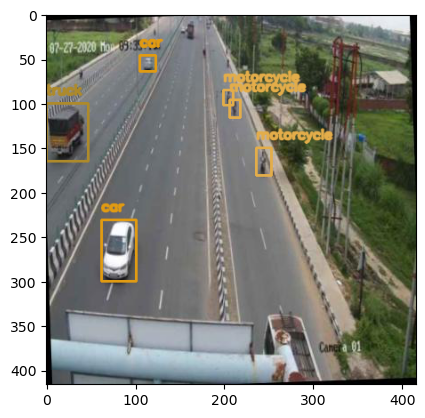

In [50]:
color_map = {1: (0, 255, 0), 3: (255, 0, 0)}  # Green for class 1, Blue for class 3

# Draw bounding boxes
output_image = draw_bounding_boxes(cv_img, voc_labels, color_map=color_map, class_names=idx_to_label)
image_rgb = cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB)
plt.imshow(image_rgb)
plt.show()

In [93]:
# # train_images_path  
# # train_labels_path 
# train_img = os.listdir(train_images_path)
# train_labels = os.listdir(train_labels_path)
# output_train = f_train_path
# output_test = test_path

# # List all files in the image folder (assumes images have extensions like .jpg, .png)
# image_files = [f for f in os.listdir(train_images_path) if os.path.isfile(os.path.join(train_images_path,  f))]

# for idx, image_file in enumerate(image_files):
#     base_name = os.path.splitext(image_file)[0]
#     # constructing corresponding annotation
#     annotation_file = f"{base_name}.txt"

#     image_path = os.path.join(train_images_path, image_file)
#     annotation_path = os.path.join(train_labels_path, annotation_file)
#     # print(f"Image path: {image_path}")
#     # print(annotation_path)
#     # getting height and width of the image 
    
#     img_id = f"image_{idx:05d}"
    
#     # img height and width
#     image_arr = cv2.imread(image_path)
#     image_height, image_width, channel = image_arr.shape
  
#     if os.path.exists(annotation_path):
#         # print(f"Processing image path: {image_path}")
#         # print(f"Processing annotation path: {annotation_path}")
#         mod_yolo = []
#         with open(annotation_path, 'r') as file:
#             for line in file:
#                 s = line.strip().split(' ')   
#                 # Convert class label and coordinates in one step
#                 # we will add 1 to the class labels, because we will use '0' as background class
#                 mod_yolo.append([int(s[0]) + 1] + [float(x) for x in s[1:]])
#         # print(f"After converting values from string: {mod_yolo}")
#         # now we will convert these boxes into VOC format from YOLO
#         voc_labels = yolo_to_voc(mod_yolo, img_height, img_width)
#         # print(f"After converting into VOC labels: {voc_labels}")
        
#         detections = []
#         detections = [{'label': label[0], 'bbox': label[1:]} for label in voc_labels]
        
#         # print(f"Dictionary format: {im_info}")

#         if idx <= num_train:
#             # destinated image path
#             img_dest_path = os.path.join(output_train, f"{img_id}.jpg")
#             # Copy the image from source to destination
#             shutil.copy(image_path, img_dest_path)
#             im_info = {
#             'img_name': img_dest_path,
#             'detections': detections
#                     }
#             # Save the image information with pickle
#             metadata_path = os.path.join(output_train, f"{img_id}.pkl")
    
#         else:
#             img_dest_path = os.path.join(output_test, f"{img_id}.jpg")
#             # Copy the image from source to destination
#             shutil.copy(image_path, img_dest_path)

#             # Save the image information with pickle
#             metadata_path = os.path.join(output_test, f"{img_id}.pkl")
        
#         with open(metadata_path, 'wb') as f:
#                 pickle.dump(im_info, f)
            
#         print(f"Processed {image_file} -> Metadata saved to {metadata_path}")

Image path: vehicle-detection/train/images/Highway_0_2020-07-30_jpg.rf.09e9d4467f17b2b870a5d1b94a38774a.jpg
Output training dir name: vehicle-detection/vehicle-train/image_00000.jpg
Height of the image: 408
Width of the image: 408
After converting values from string: [[4, 0.509804, 0.411765, 0.107843, 0.245098], [3, 0.210784, 0.616422, 0.127451, 0.232843]]
After converting into VOC labels: [[  4 189 120 234 222]
 [  3  61 208 114 304]]
Dictionary format: {'img_name': 'vehicle-detection/train/images/Highway_0_2020-07-30_jpg.rf.09e9d4467f17b2b870a5d1b94a38774a.jpg', 'detections': [{'label': 4, 'bbox': array([189, 120, 234, 222])}, {'label': 3, 'bbox': array([ 61, 208, 114, 304])}]}
Image path: vehicle-detection/train/images/Highway_0_2020-07-30_jpg.rf.7d947cc31b302b22a527ecd17d3af963.jpg
Output training dir name: vehicle-detection/vehicle-train/image_00001.jpg
Height of the image: 400
Width of the image: 400
After converting values from string: [[1, 0.50375, 0.405, 0.0975, 0.245], [2, 0.

In [88]:
print(f"Test folder: {test_path}")
print(f"Train folder: {f_train_path}")

Test folder: vehicle-detection/vehicle-test/
Train folder: vehicle-detection/vehicle-train/


In [95]:
import pickle
# Copy samples from the dataset to create train and test subsets

output_train = f_train_path
output_test = test_path

# Ensure destination directories exist
os.makedirs(output_train, exist_ok=True)
os.makedirs(output_test, exist_ok=True)

# List all files in the image folder (assuming extensions like .jpg, .png)
image_files = [f for f in os.listdir(train_images_path) if os.path.isfile(os.path.join(train_images_path, f))]


for idx, image_file in enumerate(image_files):
    base_name = os.path.splitext(image_file)[0]
    annotation_file = f"{base_name}.txt"

    image_path = os.path.join(train_images_path, image_file)
    annotation_path = os.path.join(train_labels_path, annotation_file)

    img_id = f"image_{idx:05d}"

    # Read image dimensions
    image_arr = cv2.imread(image_path)
    if image_arr is None:
        print(f"Warning: Unable to read image {image_path}. Skipping.")
        continue
    image_height, image_width, _ = image_arr.shape

    mod_yolo = []
    if os.path.exists(annotation_path):
        with open(annotation_path, 'r') as file:
            for line in file:
                s = line.strip().split(' ')
                mod_yolo.append([int(s[0]) + 1] + [float(x) for x in s[1:]])

        # Convert YOLO to VOC format
        voc_labels = yolo_to_voc(mod_yolo, image_height, image_width)

        # Create detections
        detections = [{'label': label[0], 'bbox': label[1:]} for label in voc_labels]

        # Prepare image metadata
        if idx <= num_train:
            img_dest_path = os.path.join(output_train, f"{img_id}.jpg")
            shutil.copy(image_path, img_dest_path)
            im_info = {
                'img_name': img_dest_path,
                'detections': detections
            }
            metadata_path = os.path.join(output_train, f"{img_id}.pkl")
        else:
            img_dest_path = os.path.join(output_test, f"{img_id}.jpg")
            shutil.copy(image_path, img_dest_path)
            im_info = {
                'img_name': img_dest_path,
                'detections': detections
            }
            metadata_path = os.path.join(output_test, f"{img_id}.pkl")

        # Save the image metadata in pickle format
        with open(metadata_path, 'wb') as f:
            pickle.dump(im_info, f)

        print(f"Processed {image_file} -> Metadata saved to {metadata_path}")


Processed Highway_0_2020-07-30_jpg.rf.09e9d4467f17b2b870a5d1b94a38774a.jpg -> Metadata saved to vehicle-detection/vehicle-train/image_00000.pkl
Processed Highway_0_2020-07-30_jpg.rf.7d947cc31b302b22a527ecd17d3af963.jpg -> Metadata saved to vehicle-detection/vehicle-train/image_00001.pkl
Processed Highway_0_2020-07-30_jpg.rf.f2b27ff74487ea9a91b9dff189180e8d.jpg -> Metadata saved to vehicle-detection/vehicle-train/image_00002.pkl
Processed Highway_1000_2020-07-30_jpg.rf.9a2ce6acd2c0ffd57ab44a13f084b950.jpg -> Metadata saved to vehicle-detection/vehicle-train/image_00003.pkl
Processed Highway_1000_2020-07-30_jpg.rf.e9364fb1c7d1bf9f8cbea3d1c1575050.jpg -> Metadata saved to vehicle-detection/vehicle-train/image_00004.pkl
Processed Highway_1001_2020-07-30_jpg.rf.70c4d63695312c6c33bdd45d7638425b.jpg -> Metadata saved to vehicle-detection/vehicle-train/image_00005.pkl
Processed Highway_1001_2020-07-30_jpg.rf.ced8d0ac9a9a09cd1ddbaa8c653008e8.jpg -> Metadata saved to vehicle-detection/vehicle-tr

In [98]:
print(f"Total training images: {len(os.listdir(output_train)) / 2}")
print(f"Total training labels: {len(os.listdir(output_test)) / 2}")

Total training images: 6987.0
Total training labels: 1231.0


We have converted yolo labels to voc labels, incerament label class by 1, and finally separate training and test sample with corresponding annotations. Now, we will modify our label, create custom data loader, load pre-trained faster fcrnn, train the model with our vehicle dataset and evaluate its performance

In [99]:
import pickle

# Path to the pickle file
pickle_file_path = 'vehicle-detection/vehicle-train/image_00073.pkl'

# Open the pickle file in read-binary mode
with open(pickle_file_path, 'rb') as f:
    # Load the content from the pickle file
    data = pickle.load(f)

# Print or work with the data
print(data)


{'img_name': 'vehicle-detection/vehicle-train/image_00073.jpg', 'detections': [{'label': 4, 'bbox': array([205, 131, 249, 252])}, {'label': 3, 'bbox': array([184,  75, 201,  95])}, {'label': 5, 'bbox': array([192, 112, 203, 140])}, {'label': 5, 'bbox': array([262, 197, 277, 234])}, {'label': 5, 'bbox': array([ 48,  80,  61, 104])}]}


In [3]:
import torch
import cv2
import pickle
import os
import numpy as np
import pandas as pd
import torch.nn as nn
import torch.optim as optim
import torchvision
import matplotlib.pyplot as plt
from tqdm import tqdm
from torchsummary import summary
from PIL import Image
import torch.nn.functional as F
from torch.utils.data.dataloader import DataLoader
from torch.utils.data import Dataset
import math

In [4]:
# List of labels
obj_to_idx = {
    "background":0,
    "auto":1,
    "bus":2,
    "car":3,
    "lcv":4,
    "motorcycle":5,
    "multiaxle":6,
    "tractor":7,
    "truck":8
}

# Create label-to-index and index-to-label dictionaries
idx_to_obj = {value: key for key, value in obj_to_idx.items()}
print(idx_to_obj)

{0: 'background', 1: 'auto', 2: 'bus', 3: 'car', 4: 'lcv', 5: 'motorcycle', 6: 'multiaxle', 7: 'tractor', 8: 'truck'}


In [5]:
# defining train and test path
f_train_path = "vehicle-detection/vehicle-train/"
test_path = "vehicle-detection/vehicle-test/"

In [6]:
# funtion to get pickle files length
import glob

def get_annotation(data_path):
    meta_data = glob.glob(os.path.join(data_path, "*.pkl"))
    return meta_data

train_meta = get_annotation(f_train_path)
print(f"Total annotation for train data: {len(train_meta)}")
test_meta = get_annotation(test_path)
print(f"Total annptation for test data: {len(test_meta)}")

Total annotation for train data: 6987
Total annptation for test data: 1231


In [94]:
# # PREVIOUS VERSION
# class FasterDataLoader(Dataset):
#     def __init__(self, data_path, split, transform=None, map_obj_to_idx=obj_to_idx, map_idx_to_obj=idx_to_obj):
#         """
#         Args:
#             data_path: source directory where .pkl metadata files are contained.
#             transform: Transformations to apply to images.
#             label_mapping: Optional mapping for string labels to integers.
#             split: data type -> train or validation 
#         """
#         self.data_path = data_path
#         self.transform = transform
#         self.map_obj_to_idx = map_obj_to_idx  # This is where the label mapping is stored
#         self.map_idx_to_obj = map_idx_to_obj
#         self.split = split
#         self.metadata_files = get_annotation(data_path)

#     def __len__(self):
#         return len(self.metadata_files)

#     def __getitem__(self, idx):
#         metadata_path = self.metadata_files[idx]

#         with open(metadata_path, 'rb') as f:
#             metadata = pickle.load(f)

#         image = Image.open(metadata['img_name']).convert('RGB')
#         to_flip = False
        
#         if self.split == 'train' and random.random() < 0.5:
#             to_flip = True
#             image = image.transpose(Image.FLIP_LEFT_RIGHT)
        
#         im_tensor = torchvision.transforms.ToTensor()(image)
#         detections = metadata['detections']
        
#         # Debugging the label_mapping
#         # print(f"Using label_mapping: {self.map_idx_to_obj}")
#         # print(f"label_mapping keys: {list(self.map_idx_to_obj.keys())}")
        
#         if self.map_idx_to_obj:
#             labels = [self.map_idx_to_obj[int(d['label'])] for d in detections]
#         else:
#             labels = [d['label'] for d in detections]

#         targets = {}
#         targets['bboxes'] = torch.as_tensor([detection['bbox'] for detection in metadata['detections']])
#         # print(f"Target labels: {labels}")
      
#         # Convert string labels to integer labels
#         integer_labels = [self.map_obj_to_idx[label] for label in labels]
#         # print(f"Target labels after conversion: {integer_labels}")

#         targets['labels'] = torch.as_tensor(integer_labels)
        
#         if self.transform:
#             image = self.transform(image)

#         if to_flip:
#             for idx, box in enumerate(targets['bboxes']):
#                 x1, y1, x2, y2 = box
#                 w = x2 - x1
#                 im_w = im_tensor.shape[-1]
#                 x1 = im_w - x1 - w
#                 x2 = x1 + w
#                 targets['bboxes'][idx] = torch.as_tensor([x1, y1, x2, y2])
        
#         return im_tensor, targets, metadata['img_name']


In [8]:
# from torchvision import transforms

# image_mean = [0.485, 0.456, 0.406]
# image_std = [0.229, 0.224, 0.225]

# def normalize_resize_image_and_boxes(image, bboxes, min_size=600, max_size=1000):
#         dtype, device = image.dtype, image.device

#         # normalize 
#         mean = torch.as_tensor(image_mean, dtype=dtype, device=device)
#         std = torch.as_tensor(image_std, dtype=dtype, device=device)
#         image = (image - mean[:, None, None]) / std[:, None, None]

#         # Resize to 1000x600 such that lowest size dimension 
#         # but larger dimension is not more than 1000
#         # so compute scale factor for both and scale is minimum of these two
#         h,w = image.shape[-2:]
#         im_shape = torch.tensor(image.shape[-2:])
#         min_size = torch.min(im_shape).to(dtype=torch.float32)
#         max_size = torch.max(im_shape).to(dtype=torch.float32)
#         scale =  torch.min(float(min_size) / min_size, float(max_size) / max_size)
#         scale_factor = scale.item()

#         # resize image based on scale computed 
   
#         image = torch.nn.functional.interpolate(
#             image,
#             size=None,
#             scale_factor=scale_factor,
#             mode="bilinear",
#             recompute_scale_factor= True,
#             align_corners=False,
#         )

#         if bboxes is not None:
#             # resize bbox by 
#             ratios = [
#                 torch.tensor(s, dtype=torch.float32, device=bboxes.device)
#                 / torch.tensor(s_orig, dtype= torch.float32, device=bboxes.device)
#                 for s, s_orig in zip(image.shape[-2:], (h,w))
#             ]
#             ratio_height, ratio_width = ratios
#             xmin, ymin, xmax, ymax = bboxes.unbind(2)
#             xmin = xmin * ratio_width
#             xmax = xmax * ratio_width
#             ymin = ymin * ratio_height
#             ymax = ymax * ratio_height
#             bboxes = torch.stack((xmin, ymin, xmax, ymax), dim=2)
#         return image, bboxes

In [293]:
# from here 
image_mean = [0.485, 0.456, 0.406]
image_std = [0.229, 0.224, 0.225]
def normalize_resize_image_and_boxes(image, bboxes, target_size=(600, 1000)):
    """
    Normalize and resize an image to a fixed target size, adjusting bounding boxes accordingly.
    
    Args:
        image: Tensor of shape [C, H, W].
        bboxes: Tensor of shape [num_boxes, 4].
        target_size: Tuple (height, width) specifying the desired output size.
    
    Returns:
        image: Resized and normalized image tensor of shape [C, target_height, target_width].
        bboxes: Adjusted bounding boxes tensor of shape [num_boxes, 4].
    """
    dtype, device = image.dtype, image.device
    target_height, target_width = target_size

    # debug 
    # # print(f"Original image size: {image.shape}")
    # # print(f"Original bboxes: {bboxes}")
    # if bboxes is not None:
    #     # print(f"Shape of bboxes before processing: {bboxes.shape}")

    # Normalize
    mean = torch.as_tensor(image_mean, dtype=dtype, device=device)
    std = torch.as_tensor(image_std, dtype=dtype, device=device)
    image = (image - mean[:, None, None]) / std[:, None, None]

    # Original dimensions
    orig_height, orig_width = image.shape[1:]
    # print(f"Original height: {orig_height}, Original width: {orig_width}")

    # Resize the image
    image = torch.nn.functional.interpolate(
        image.unsqueeze(0),  # Add batch dimension
        size=target_size,
        mode="bilinear",
        align_corners=False
    ).squeeze(0)  # Remove batch dimension

    # Resize bounding boxes (main)
    # if bboxes is not None:
    #     height_scale = target_height / orig_height
    #     width_scale = target_width / orig_width
    #     xmin, ymin, xmax, ymax = bboxes.unbind(1)
    #     xmin = xmin * width_scale
    #     xmax = xmax * width_scale
    #     ymin = ymin * height_scale
    #     ymax = ymax * height_scale
    #     bboxes = torch.stack((xmin, ymin, xmax, ymax), dim=1)

    # debug
    height_scale = target_height / orig_height
    width_scale = target_width / orig_width
    if bboxes is not None:
        try:
            xmin, ymin, xmax, ymax = bboxes.unbind(1)  # Check unbinding here
        except Exception as e:
            print(f"Error during unbind: {e}")
            print(f"Shape of bboxes during unbind attempt: {bboxes.shape}")
            raise

        xmin = xmin * width_scale
        xmax = xmax * width_scale
        ymin = ymin * height_scale
        ymax = ymax * height_scale
        bboxes = torch.stack((xmin, ymin, xmax, ymax), dim=1)
   
    # print(f"Shape of bboxes after processing: {bboxes.shape}")
    return image, bboxes



In [421]:
class FasterDataLoader(Dataset):
    def __init__(self, data_path, split, transform=None, map_obj_to_idx=obj_to_idx, map_idx_to_obj=idx_to_obj):
        self.data_path = data_path
        self.transform = transform
        self.map_obj_to_idx = map_obj_to_idx
        self.map_idx_to_obj = map_idx_to_obj
        self.split = split
        self.metadata_files = get_annotation(data_path)

    def __len__(self):
        return len(self.metadata_files)

    # def _has_valid_annotations(self, metadata_path):
    #     with open(metadata_path, 'rb') as f:
    #         metadata = pickle.load(f)
    #     return len(metadata['detections']) > 0

    def __getitem__(self, idx):
        metadata_path = self.metadata_files[idx]

        with open(metadata_path, 'rb') as f:
            metadata = pickle.load(f)

        # Load and process the image
        image = Image.open(metadata['img_name']).convert('RGB')
        im_tensor = torchvision.transforms.ToTensor()(image)

        detections = metadata['detections']
        if self.map_idx_to_obj:
            labels = [self.map_idx_to_obj[int(d['label'])] for d in detections]
        else:
            labels = [d['label'] for d in detections]

        targets = {}
        
        targets['bboxes'] = torch.as_tensor([detection['bbox'] for detection in detections])
        integer_labels = [self.map_obj_to_idx[label] for label in labels]
        targets['labels'] = torch.as_tensor(integer_labels)

        # debug
        # print(f"Index {idx}:")
        # print(f"  Image size: {image.size}")
        # print(f"  Targets: {targets}")
        # print(f"  Targets[bboxes]: {targets['bboxes']} (Shape: {targets['bboxes'].shape})")

        # Handle images with no bounding boxes
        if targets['bboxes'].numel() == 0:  # No bounding boxes
            print(f"Skipping image {metadata['img_name']} with no bounding boxes.")
            return None  # Signal to skip this entry

        # Apply normalization and resizing
        # im_tensor, targets['bboxes'] = normalize_resize_image_and_boxes(im_tensor, targets['bboxes'])
        if self.split == 'train':
            im_tensor, targets['bboxes'] = normalize_resize_image_and_boxes(im_tensor, targets['bboxes'])
        else:
            # im_tensor, _ = normalize_resize_image_and_boxes(im_tensor, None)  # Only normalize image for test
            im_tensor, targets['bboxes'] = normalize_resize_image_and_boxes(im_tensor, targets['bboxes'])

        return im_tensor, targets, metadata['img_name']


In [422]:
# laoding train and validation data 
train_data = FasterDataLoader(f_train_path, split="train", transform=None, map_obj_to_idx=obj_to_idx, map_idx_to_obj=idx_to_obj)
test_data = FasterDataLoader(test_path, split="validation", transform=None, map_obj_to_idx=obj_to_idx, map_idx_to_obj=idx_to_obj)

In [297]:
train_data[123][0].shape

torch.Size([3, 600, 1000])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1179042..2.5934143].


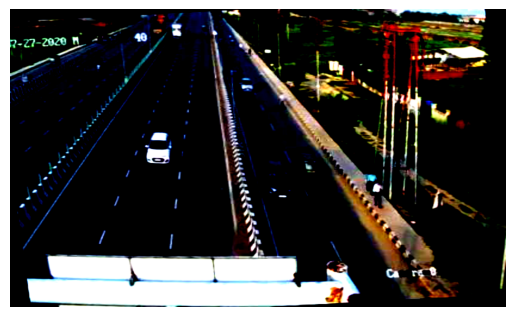

In [298]:
image_tensor = train_data[123][0]

# Convert to [H, W, C] by permuting the dimensions
image_tensor = image_tensor.permute(1, 2, 0).cpu().numpy()

# Plot the image
plt.imshow(image_tensor)
plt.axis('off')  # Hide axis
plt.show()

In [123]:
# def custom_collate_fn(batch):
#     """
#     Custom collate function to handle variable number of bounding boxes.
#     Args:
#         batch: List of tuples (image, target, img_name).
#     Returns:
#         images: Stacked image tensors [batch_size, C, H, W].
#         targets: Dictionary with 'bboxes' and 'labels', each as a list of tensors.
#         img_names: List of image names.
#     """
#     images = torch.stack([item[0] for item in batch])  # Stack images [batch_size, C, H, W]
#     img_names = [item[2] for item in batch]           # List of image names

#     # Targets are grouped into a dictionary
#     targets = {
#         'bboxes': [item[1]['bboxes'] for item in batch],  # List of bounding boxes tensors
#         'labels': [item[1]['labels'] for item in batch],  # List of label tensors
#     }

#     return images, targets, img_names


In [268]:
# BEFORE DEALING WITH THE MISSING BOUNDING BOX ANNOTATION
# def custom_collate_fn(batch):
#     """
#     Custom collate function to handle variable number of bounding boxes.
#     Args:
#         batch: List of tuples (image, target, img_name).
#     Returns:
#         images: Stacked image tensors [batch_size, C, H, W].
#         targets: List of dictionaries, each containing 'bboxes' and 'labels' tensors.
#         img_names: List of image names.
#     """
#     images = torch.stack([item[0] for item in batch])  # Stack images [batch_size, C, H, W]
#     img_names = [item[2] for item in batch]           # List of image names

#     # Targets should be a list of dictionaries, each with 'bboxes' and 'labels'
#     targets = [
#         {
#             'bboxes': item[1]['bboxes'],  # Bounding boxes tensor
#             'labels': item[1]['labels'],  # Label tensor
#         }
#         for item in batch
#     ]

#     return images, targets, img_names


In [423]:
def custom_collate_fn(batch):
    """
    Custom collate function to handle variable number of bounding boxes.
    Skips None entries dynamically.
    Args:
        batch: List of tuples (image, target, img_name) or None.
    Returns:
        images: Stacked image tensors [batch_size, C, H, W].
        targets: List of dictionaries, each containing 'bboxes' and 'labels' tensors.
        img_names: List of image names.
    """
    # Filter out None entries
    valid_batch = [item for item in batch if item is not None]

    if len(valid_batch) == 0:
        raise ValueError("All batch items are None. Check your dataset or filtering logic.")

    # Stack images
    images = torch.stack([item[0] for item in valid_batch])  # Stacked image tensors [batch_size, C, H, W]
    img_names = [item[2] for item in valid_batch]           # List of image names

    # Prepare targets as a list of dictionaries
    targets = [
        {
            'bboxes': item[1]['bboxes'],  # Bounding boxes tensor
            'labels': item[1]['labels'],  # Labels tensor
        }
        for item in valid_batch
    ]

    return images, targets, img_names


In [300]:
train_loader = DataLoader(
    train_data,
    batch_size=4,               # Adjust batch size as needed
    shuffle=True,             # Adjust number of workers based on your system
    collate_fn=custom_collate_fn  # Use the custom collate function
)


In [262]:
# debug 
# debug
for i, (im, targets, fname) in enumerate(train_loader):
    print(f"Batch {i}:")
    print(f"Image shape: {im.shape}")
    for t_idx, target in enumerate(targets):
        print(f"Target {t_idx}:")
        print(f"  Boxes: {target['bboxes']}")
        print(f"  Shape of Boxes: {target['bboxes'].shape}")
        print(f"  Labels: {target['labels']}")
        print(f"  Filename: {fname[t_idx]}")
    if i >= 2:  # Inspect first 3 batches
        break


Index 2255:
  Image size: (402, 402)
  Targets: {'bboxes': tensor([[141, 270, 161, 309],
        [218, 226, 257, 292],
        [130,  24, 150,  65]], dtype=torch.int32), 'labels': tensor([5, 3, 8])}
  Targets[bboxes]: tensor([[141, 270, 161, 309],
        [218, 226, 257, 292],
        [130,  24, 150,  65]], dtype=torch.int32) (Shape: torch.Size([3, 4]))
Original image size: torch.Size([3, 402, 402])
Original bboxes: tensor([[141, 270, 161, 309],
        [218, 226, 257, 292],
        [130,  24, 150,  65]], dtype=torch.int32)
Shape of bboxes before processing: torch.Size([3, 4])
Original height: 402, Original width: 402
Shape of bboxes after processing: torch.Size([3, 4])
Index 1313:
  Image size: (416, 416)
  Targets: {'bboxes': tensor([[  0, 118, 112, 348],
        [148, 209, 170, 252],
        [156,  93, 174, 121],
        [199, 109, 216, 134]], dtype=torch.int32), 'labels': tensor([6, 5, 5, 5])}
  Targets[bboxes]: tensor([[  0, 118, 112, 348],
        [148, 209, 170, 252],
        [1

In [301]:
for i, (im, targets, fname) in enumerate(train_loader):
    for t_idx, target in enumerate(targets):
        if target['bboxes'].numel() == 0:  # Check if bounding boxes are empty
            print(f"Empty bounding boxes at index {i}, target {t_idx}")
            continue
        if target['bboxes'].ndim != 2 or target['bboxes'].size(1) != 4:
            print(f"Unexpected bbox shape at index {i}, target {t_idx}: {target['bboxes'].shape}")
            raise ValueError("Bounding boxes must have shape [N, 4]")


Skipping image vehicle-detection/vehicle-train/image_06116.jpg with no bounding boxes.
Skipping image vehicle-detection/vehicle-train/image_06316.jpg with no bounding boxes.
Skipping image vehicle-detection/vehicle-train/image_06302.jpg with no bounding boxes.
Skipping image vehicle-detection/vehicle-train/image_06119.jpg with no bounding boxes.
Skipping image vehicle-detection/vehicle-train/image_06397.jpg with no bounding boxes.
Skipping image vehicle-detection/vehicle-train/image_06262.jpg with no bounding boxes.
Skipping image vehicle-detection/vehicle-train/image_06062.jpg with no bounding boxes.
Skipping image vehicle-detection/vehicle-train/image_05851.jpg with no bounding boxes.
Skipping image vehicle-detection/vehicle-train/image_05858.jpg with no bounding boxes.
Skipping image vehicle-detection/vehicle-train/image_06433.jpg with no bounding boxes.
Skipping image vehicle-detection/vehicle-train/image_05876.jpg with no bounding boxes.
Skipping image vehicle-detection/vehicle-tr

In [424]:
test_loader = DataLoader(
    test_data,
    batch_size=4,               # Adjust batch size as needed
    shuffle=True,             # Adjust number of workers based on your system
    collate_fn=custom_collate_fn  # Use the custom collate function
)

In [425]:
# debug 
# debug
for i, (im, targets, fname) in enumerate(test_loader):
    print(f"Batch {i}:")
    print(f"Image shape: {im.shape}")
    for t_idx, target in enumerate(targets):
        print(f"Target {t_idx}:")
        print(f"  Boxes: {target['bboxes']}")
        print(f"  Shape of Boxes: {target['bboxes'].shape}")
        print(f"  Labels: {target['labels']}")
        print(f"  Filename: {fname[t_idx]}")
    if i >= 2:  # Inspect first 3 batches
        break


Batch 0:
Image shape: torch.Size([4, 3, 600, 1000])
Target 0:
  Boxes: tensor([[512.0192, 222.1154, 560.0962, 282.6923],
        [853.3654, 357.6923, 903.8462, 437.0192],
        [519.2308, 147.1154, 540.8654, 170.1923],
        [552.8846, 418.2692, 682.6923, 600.0000]])
  Shape of Boxes: torch.Size([4, 4])
  Labels: tensor([3, 5, 3, 3])
  Filename: vehicle-detection/vehicle-test/image_07620.jpg
Target 1:
  Boxes: tensor([[418.2693, 259.6154, 531.2500, 422.5962],
        [387.0193,  47.5962, 427.8846,  95.1923],
        [423.0769,  20.1923, 468.7500,  63.4615],
        [625.0000,  62.0192, 658.6539, 108.1731]])
  Shape of Boxes: torch.Size([4, 4])
  Labels: tensor([3, 3, 3, 5])
  Filename: vehicle-detection/vehicle-test/image_07987.jpg
Target 2:
  Boxes: tensor([[384.6154, 249.5192, 605.7693, 600.0000]])
  Shape of Boxes: torch.Size([1, 4])
  Labels: tensor([6])
  Filename: vehicle-detection/vehicle-test/image_07510.jpg
Target 3:
  Boxes: tensor([[338.9423,  98.0769, 411.0577, 206.2500

In [54]:
# # Create DataLoader instances
# train_loader = DataLoader(train_data, batch_size=8, shuffle=True)
# test_loader = DataLoader(test_data, batch_size=8, shuffle=False)

In [302]:
# Iterate through the train DataLoader
for images, targets, img_names in train_loader:
    print(f"Image batch shape: {images.shape}")  # Expected: [batch_size, 3, 600, 1000]
    print(f"Images: {images}")
    
    # Since targets is a list of dictionaries, access the first dictionary
    print(f"Bounding boxes (first image): {targets[0]['bboxes'].shape}")  # Variable shape, e.g., [num_boxes, 4]
    print(f"Bounding Boxes: {targets[0]['bboxes']}")
    
    # Access the labels from the first image's dictionary
    print(f"Labels (first image): {targets[0]['labels'].shape}")  # Variable shape, e.g., [num_boxes]
    print(f"Labels: {targets[0]['labels']}")
    break


Image batch shape: torch.Size([4, 3, 600, 1000])
Images: tensor([[[[-1.9124, -1.9124, -1.9124,  ..., -1.7925, -1.7925, -1.7925],
          [-1.9124, -1.9124, -1.9124,  ..., -1.7925, -1.7925, -1.7925],
          [-1.9124, -1.9124, -1.9124,  ..., -1.7925, -1.7925, -1.7925],
          ...,
          [-1.4951, -1.5048, -1.5374,  ...,  0.0360,  0.0218,  0.0176],
          [-1.5949, -1.5874, -1.5624,  ..., -0.0074, -0.0217, -0.0259],
          [-1.6042, -1.5829, -1.5117,  ..., -0.0444, -0.0587, -0.0629]],

         [[-1.7556, -1.7556, -1.7556,  ..., -1.6856, -1.6856, -1.6856],
          [-1.7556, -1.7556, -1.7556,  ..., -1.6856, -1.6856, -1.6856],
          [-1.7556, -1.7556, -1.7556,  ..., -1.6856, -1.6856, -1.6856],
          ...,
          [-1.1458, -1.1557, -1.1889,  ...,  0.2539,  0.2393,  0.2349],
          [-1.2560, -1.2483, -1.2227,  ...,  0.2094,  0.1948,  0.1905],
          [-1.2654, -1.2437, -1.1709,  ...,  0.1716,  0.1570,  0.1527]],

         [[-1.5430, -1.5430, -1.5430,  ..., -

In [303]:
targets

[{'bboxes': tensor([[377.4039, 175.9615, 519.2308, 465.8654]]),
  'labels': tensor([8])},
 {'bboxes': tensor([[228.3654, 229.3269, 286.0577, 307.2115],
          [483.1731, 145.6731, 531.2500, 197.5962]]),
  'labels': tensor([3, 3])},
 {'bboxes': tensor([[659.3750, 277.5000, 759.3750, 375.0000],
          [337.5000, 320.6250, 431.2500, 432.1875],
          [557.8125, 179.0625, 610.9375, 240.0000],
          [559.3750, 103.1250, 601.5625, 139.6875],
          [745.3125, 217.5000, 789.0625, 275.6250]]),
  'labels': tensor([3, 3, 3, 3, 5])},
 {'bboxes': tensor([[336.5385, 330.2885, 394.2308, 474.5192],
          [271.6346, 147.1154, 362.9808, 263.9423]]),
  'labels': tensor([4, 8])}]

In [182]:
for target in targets:
    print(target)
    box = target['bboxes']
    print(box)

{'bboxes': tensor([[459.1346,  56.2500, 610.5770, 318.7500]]), 'labels': tensor([6])}
tensor([[459.1346,  56.2500, 610.5770, 318.7500]])
{'bboxes': tensor([[ 90.6250,  75.9375, 221.8750, 295.3125]]), 'labels': tensor([6])}
tensor([[ 90.6250,  75.9375, 221.8750, 295.3125]])
{'bboxes': tensor([[ 68.7500, 155.6250, 181.2500, 319.6875],
        [114.0625,  30.0000, 173.4375, 108.7500]]), 'labels': tensor([4, 2])}
tensor([[ 68.7500, 155.6250, 181.2500, 319.6875],
        [114.0625,  30.0000, 173.4375, 108.7500]])
{'bboxes': tensor([[257.8125, 147.1875, 303.1250, 186.5625],
        [143.7500, 331.8750, 271.8750, 511.8750]]), 'labels': tensor([3, 3])}
tensor([[257.8125, 147.1875, 303.1250, 186.5625],
        [143.7500, 331.8750, 271.8750, 511.8750]])


In [304]:
# laoding train and validation data 
train_loader = DataLoader(
    train_data,
    batch_size=4,               # Adjust batch size as needed
    shuffle=True,             # Adjust number of workers based on your system
    collate_fn=custom_collate_fn  # Use the custom collate function
)

test_loader = DataLoader(
    test_data,
    batch_size=4,               # Adjust batch size as needed
    shuffle=True,             # Adjust number of workers based on your system
    collate_fn=custom_collate_fn  # Use the custom collate function
)


In [305]:
print(f"Total samples in the training data: {len(train_data)}")
print(f"Total samples in the test data: {len(test_data)}")

Total samples in the training data: 6987
Total samples in the test data: 1231


In [306]:
obj_to_idx

{'background': 0,
 'auto': 1,
 'bus': 2,
 'car': 3,
 'lcv': 4,
 'motorcycle': 5,
 'multiaxle': 6,
 'tractor': 7,
 'truck': 8}

In [307]:
# check a sample data from the train loader 
from torchvision import transforms
import random
train_data[22]

(tensor([[[-2.1179, -2.1179, -2.1179,  ..., -2.1179, -2.1179, -2.1179],
          [-2.1179, -2.1179, -2.1179,  ..., -2.1179, -2.1179, -2.1179],
          [-2.1179, -2.1179, -2.1179,  ..., -2.1139, -2.1139, -2.1139],
          ...,
          [-2.1179, -2.1179, -2.1179,  ..., -2.1179, -2.1179, -2.1179],
          [-2.1179, -2.1179, -2.1179,  ..., -2.1179, -2.1179, -2.1179],
          [-2.1179, -2.1179, -2.1179,  ..., -2.1179, -2.1179, -2.1179]],
 
         [[-2.0182, -2.0182, -2.0182,  ..., -2.0357, -2.0357, -2.0357],
          [-2.0182, -2.0182, -2.0182,  ..., -2.0357, -2.0357, -2.0357],
          [-2.0182, -2.0182, -2.0182,  ..., -2.0357, -2.0357, -2.0357],
          ...,
          [-2.0223, -2.0223, -2.0223,  ..., -2.0182, -2.0182, -2.0182],
          [-2.0182, -2.0182, -2.0182,  ..., -2.0182, -2.0182, -2.0182],
          [-2.0182, -2.0182, -2.0182,  ..., -2.0182, -2.0182, -2.0182]],
 
         [[-1.8044, -1.8044, -1.8044,  ..., -1.8044, -1.8044, -1.8044],
          [-1.8044, -1.8044,

In [39]:
for i in range(100):
    print(train_data[i][0].shape)

torch.Size([3, 408, 408])
torch.Size([3, 400, 400])
torch.Size([3, 402, 402])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 390, 390])
torch.Size([3, 392, 392])
torch.Size([3, 402, 402])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([3, 416, 416])
torch.Size([

In [308]:
for i in range(10):
    print(train_data[i][0].shape)

torch.Size([3, 600, 1000])
torch.Size([3, 600, 1000])
torch.Size([3, 600, 1000])
torch.Size([3, 600, 1000])
torch.Size([3, 600, 1000])
torch.Size([3, 600, 1000])
torch.Size([3, 600, 1000])
torch.Size([3, 600, 1000])
torch.Size([3, 600, 1000])
torch.Size([3, 600, 1000])


#### Loading pre-trained Faster RCNN

In [309]:
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection.anchor_utils import AnchorGenerator
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.models.detection import FasterRCNN_ResNet50_FPN_Weights

In [310]:
# function to build faster rcnn 
def build_faster_rcnn(model_params, fully_pretrained=True):
    if fully_pretrained == True:
        faster_rcnn_model = torchvision.models.detection.fasterrcnn_resnet50_fpn(
            weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT,
            min_size= model_params['min_size'],
            max_size= model_params['max_size']
        )
        
        faster_rcnn_model.roi_heads.box_predictor = FastRCNNPredictor(
            faster_rcnn_model.roi_heads.box_predictor.cls_score.in_features,
            num_classes= model_params['num_classes'])
    else:
        backbone = torchvision.models.resnet34(pretrained=True, norm_layer=torchvision.ops.FrozenBatchNorm2d)
        backbone = torch.nn.Sequential(*list(backbone.children())[:-3])
        backbone.out_channels = 256
        roi_align = torchvision.ops.MultiScaleRoIAlign(featmap_names=['0'], output_size=7, sampling_ratio=2)
        rpn_anchor_generator = AnchorGenerator()
        faster_rcnn_model = torchvision.models.detection.FasterRCNN(backbone,
                                                                    num_classes=model_params['num_classes'],
                                                                    min_size=model_params['min_size'],
                                                                    max_size=model_params['max_size'],
                                                                    rpn_anchor_generator=rpn_anchor_generator,
                                                                    rpn_pre_nms_top_n_train= model_params['rpn_pre_nms_top_n_train'],
                                                                    rpn_pre_nms_top_n_test= model_params['rpn_pre_nms_top_n_test'],
                                                                    box_batch_size_per_image= model_params['box_batch_size_per_image'],
                                                                    rpn_post_nms_top_n_test= model_params['rpn_post_nms_top_n_test']
                                                                    )
        
    return faster_rcnn_model

In [311]:
model_params= {
    'min_size': 600,
    'max_size': 1000,
    'num_classes': 9,
    'rpn_pre_nms_top_n_train': 12000,
    'rpn_pre_nms_top_n_test': 6000,
    'box_batch_size_per_image':128,
    'rpn_post_nms_top_n_test': 300
}

pre_trained_model = build_faster_rcnn(model_params, fully_pretrained=True)

In [135]:
pre_trained_model

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(600,), max_size=1000, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

In [312]:
device = ('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


In [190]:
# device = 'cpu'

In [313]:
# defining optimizer, learning rate, epoch and others for training

import torch.optim as optim
from torch.optim.lr_scheduler import MultiStepLR

learning_rate = 0.0001
lr_steps = [12, 16]
num_epochs = 20
seed = 1111

pre_trained_model.to(device)

optimizer = optim.SGD(lr=learning_rate,
                                params=filter(lambda p: p.requires_grad,
                                              pre_trained_model.parameters()),
                                weight_decay=5E-4,
                                momentum=0.9)
scheduler = MultiStepLR(optimizer, milestones=lr_steps, gamma=0.1)

In [316]:
# FINAL TRAINING FUNCTION
def train(model, train_loader, num_epochs, lr, optimizer, scheduler, seed, save_dir, best_model_name="best_model.pth", checkpoint_name="checkpoint.pth"):
    acc_steps = 1
    step_count = 1
    torch.manual_seed(seed)
    np.random.seed(seed)
    random.seed(seed)
    if device == 'cuda':
        torch.cuda.manual_seed_all(seed)
    model.to(device)

    # To track the minimum loss and save the best model
    min_loss = float('inf')
    best_model_path = os.path.join(save_dir, best_model_name)
    checkpoint_path = os.path.join(save_dir, checkpoint_name)

    for epoch in range(num_epochs):
        rpn_classification_losses = []
        rpn_localization_losses = []
        frcnn_classification_losses = []
        frcnn_localization_losses = []
        optimizer.zero_grad()

        for im, targets, fname in tqdm(train_loader):
            im = im.float().to(device)
           
            for target in targets:
                # Rename 'bboxes' to 'boxes', convert to float, and move to device
                target["boxes"] = target.pop("bboxes").float().to(device)
                target['labels'] = target['labels'].long().to(device)  # Convert labels to tensor and move to device
                # print(f"Target Boxes: {target['boxes']}")

            
            # Forward pass: Get the outputs (losses, predictions)
            output = model(im, targets)

            # Output from the model: {'loss_classifier': tensor(1.7436, grad_fn=<NllLossBackward0>), 
            # 'loss_box_reg': tensor(0.0662, grad_fn=<DivBackward0>), 
            # 'loss_objectness': tensor(0.2460, grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), 
            # 'loss_rpn_box_reg': tensor(0.0282, grad_fn=<DivBackward0>)}

            # Extract the total loss and RPN & FRCNN losses from the output
            rpn_loss = output['loss_objectness'] + output['loss_rpn_box_reg']
            frcnn_loss = output['loss_classifier'] + output['loss_box_reg']  # Use the classification and box reg loss from Fast R-CNN

            loss = rpn_loss + frcnn_loss  # Total loss
            rpn_classification_losses.append(output['loss_objectness'].item())
            rpn_localization_losses.append(output['loss_rpn_box_reg'].item())
            frcnn_classification_losses.append(output['loss_classifier'].item())
            frcnn_localization_losses.append(output['loss_box_reg'].item())

            loss = loss / acc_steps
            loss.backward()

            if step_count % acc_steps == 0:
                optimizer.step()
                optimizer.zero_grad()
            step_count += 1

        # Calculate average losses for the epoch
        avg_rpn_cls_loss = np.mean(rpn_classification_losses)
        avg_rpn_loc_loss = np.mean(rpn_localization_losses)
        avg_frcnn_cls_loss = np.mean(frcnn_classification_losses)
        avg_frcnn_loc_loss = np.mean(frcnn_localization_losses)
        epoch_loss = avg_rpn_cls_loss + avg_rpn_loc_loss + avg_frcnn_cls_loss + avg_frcnn_loc_loss

        # Print epoch loss values
        print(f'Finished epoch {epoch + 1}')
        print(f'Epoch Loss: {epoch_loss:.4f}')
        print(f'RPN Classification Loss: {avg_rpn_cls_loss:.4f} | RPN Localization Loss: {avg_rpn_loc_loss:.4f}')
        print(f'FRCNN Classification Loss: {avg_frcnn_cls_loss:.4f} | FRCNN Localization Loss: {avg_frcnn_loc_loss:.4f}')

        # Save the model if this is the best loss so far
        if epoch_loss < min_loss:
            min_loss = epoch_loss
            torch.save(model.state_dict(), best_model_path)
            print(f"Saved best model with loss {min_loss:.4f}")

        # Save the latest checkpoint
        torch.save(model.state_dict(), checkpoint_path)

        # Step the learning rate scheduler
        scheduler.step()

    print('Done Training...')


In [317]:
import math
root_path = "vehicle-detection/"
save_dir = root_path + 'model/' # Directory to save models
os.makedirs(save_dir, exist_ok=True)

# Train the model
train(
    model=pre_trained_model,
    train_loader=train_loader,
    num_epochs=20,
    lr=0.0001,
    optimizer=optimizer,
    scheduler=scheduler,
    seed=seed,
    save_dir=save_dir,
    best_model_name="pt_faster_rcnn_best.pth",
    checkpoint_name="pt_faster_rcnn_checkpoint.pth"
)


  9%|▉         | 154/1747 [03:42<38:50,  1.46s/it]

Skipping image vehicle-detection/vehicle-train/image_06062.jpg with no bounding boxes.


  9%|▉         | 162/1747 [03:53<37:36,  1.42s/it]

Skipping image vehicle-detection/vehicle-train/image_05954.jpg with no bounding boxes.


 23%|██▎       | 399/1747 [09:36<32:37,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06397.jpg with no bounding boxes.


 26%|██▌       | 454/1747 [10:55<31:17,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05786.jpg with no bounding boxes.


 43%|████▎     | 756/1747 [18:12<23:56,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06302.jpg with no bounding boxes.


 56%|█████▌    | 977/1747 [23:32<18:39,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06116.jpg with no bounding boxes.


 58%|█████▊    | 1005/1747 [24:11<17:56,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05876.jpg with no bounding boxes.


 63%|██████▎   | 1097/1747 [26:24<15:41,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05851.jpg with no bounding boxes.


 68%|██████▊   | 1194/1747 [28:44<13:21,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06262.jpg with no bounding boxes.


 80%|████████  | 1399/1747 [33:41<08:25,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06031.jpg with no bounding boxes.


 81%|████████  | 1416/1747 [34:05<08:01,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06119.jpg with no bounding boxes.


 83%|████████▎ | 1443/1747 [34:43<07:21,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06316.jpg with no bounding boxes.


 88%|████████▊ | 1541/1747 [37:05<04:59,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05949.jpg with no bounding boxes.


 96%|█████████▌| 1681/1747 [40:28<01:30,  1.36s/it]

Skipping image vehicle-detection/vehicle-train/image_05858.jpg with no bounding boxes.


 97%|█████████▋| 1701/1747 [40:56<01:06,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06433.jpg with no bounding boxes.


100%|██████████| 1747/1747 [42:02<00:00,  1.44s/it]


Finished epoch 1
Epoch Loss: 0.5513
RPN Classification Loss: 0.0242 | RPN Localization Loss: 0.0091
FRCNN Classification Loss: 0.2347 | FRCNN Localization Loss: 0.2834
Saved best model with loss 0.5513


 10%|▉         | 169/1747 [04:04<38:08,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06031.jpg with no bounding boxes.


 14%|█▍        | 252/1747 [06:04<36:11,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06119.jpg with no bounding boxes.


 14%|█▍        | 253/1747 [06:05<35:30,  1.43s/it]

Skipping image vehicle-detection/vehicle-train/image_05876.jpg with no bounding boxes.


 27%|██▋       | 477/1747 [11:29<30:44,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05949.jpg with no bounding boxes.


 30%|██▉       | 524/1747 [12:37<29:29,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06116.jpg with no bounding boxes.


 39%|███▉      | 687/1747 [16:33<24:58,  1.41s/it]

Skipping image vehicle-detection/vehicle-train/image_05851.jpg with no bounding boxes.


 64%|██████▎   | 1112/1747 [26:47<15:18,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06262.jpg with no bounding boxes.


 67%|██████▋   | 1167/1747 [28:06<14:00,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05786.jpg with no bounding boxes.


 70%|██████▉   | 1219/1747 [29:20<12:43,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06316.jpg with no bounding boxes.


 86%|████████▌ | 1498/1747 [36:03<06:00,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06302.jpg with no bounding boxes.


 89%|████████▉ | 1562/1747 [37:35<04:28,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06433.jpg with no bounding boxes.


 91%|█████████▏| 1597/1747 [38:25<03:37,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06397.jpg with no bounding boxes.


 95%|█████████▍| 1657/1747 [39:52<02:12,  1.47s/it]

Skipping image vehicle-detection/vehicle-train/image_05858.jpg with no bounding boxes.


 96%|█████████▌| 1679/1747 [40:23<01:38,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05954.jpg with no bounding boxes.


 97%|█████████▋| 1693/1747 [40:42<01:17,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_06062.jpg with no bounding boxes.


100%|██████████| 1747/1747 [42:00<00:00,  1.44s/it]


Finished epoch 2
Epoch Loss: 0.4353
RPN Classification Loss: 0.0130 | RPN Localization Loss: 0.0068
FRCNN Classification Loss: 0.1857 | FRCNN Localization Loss: 0.2298
Saved best model with loss 0.4353


 23%|██▎       | 408/1747 [09:50<32:16,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05858.jpg with no bounding boxes.


 27%|██▋       | 470/1747 [11:19<30:52,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06031.jpg with no bounding boxes.


 27%|██▋       | 478/1747 [11:30<30:04,  1.42s/it]

Skipping image vehicle-detection/vehicle-train/image_05851.jpg with no bounding boxes.


 29%|██▉       | 504/1747 [12:07<29:57,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05954.jpg with no bounding boxes.


 34%|███▎      | 589/1747 [14:09<27:52,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_05876.jpg with no bounding boxes.


 39%|███▉      | 688/1747 [16:32<25:27,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_06433.jpg with no bounding boxes.


 41%|████      | 715/1747 [17:10<24:34,  1.43s/it]

Skipping image vehicle-detection/vehicle-train/image_06262.jpg with no bounding boxes.


 64%|██████▍   | 1117/1747 [26:54<14:54,  1.42s/it]

Skipping image vehicle-detection/vehicle-train/image_05786.jpg with no bounding boxes.


 67%|██████▋   | 1171/1747 [28:11<13:52,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_06116.jpg with no bounding boxes.


 69%|██████▉   | 1206/1747 [29:01<13:02,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06062.jpg with no bounding boxes.


 71%|███████   | 1240/1747 [29:50<12:14,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06302.jpg with no bounding boxes.


 74%|███████▎  | 1287/1747 [30:57<11:04,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06397.jpg with no bounding boxes.


 86%|████████▋ | 1509/1747 [36:18<05:44,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06316.jpg with no bounding boxes.


 88%|████████▊ | 1543/1747 [37:06<04:49,  1.42s/it]

Skipping image vehicle-detection/vehicle-train/image_05949.jpg with no bounding boxes.


 92%|█████████▏| 1604/1747 [38:34<03:27,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06119.jpg with no bounding boxes.


100%|██████████| 1747/1747 [42:00<00:00,  1.44s/it]


Finished epoch 3
Epoch Loss: 0.3936
RPN Classification Loss: 0.0098 | RPN Localization Loss: 0.0062
FRCNN Classification Loss: 0.1671 | FRCNN Localization Loss: 0.2105
Saved best model with loss 0.3936


  1%|          | 12/1747 [00:16<41:53,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06397.jpg with no bounding boxes.


 12%|█▏        | 214/1747 [05:08<37:00,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06062.jpg with no bounding boxes.


 14%|█▍        | 245/1747 [05:53<35:56,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_05851.jpg with no bounding boxes.


 27%|██▋       | 471/1747 [11:22<30:54,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06316.jpg with no bounding boxes.


 34%|███▍      | 594/1747 [14:19<27:48,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06119.jpg with no bounding boxes.


 40%|████      | 705/1747 [16:59<25:08,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06262.jpg with no bounding boxes.


 56%|█████▌    | 974/1747 [23:27<18:39,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06302.jpg with no bounding boxes.


 58%|█████▊    | 1014/1747 [24:25<17:40,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05954.jpg with no bounding boxes.


 61%|██████    | 1060/1747 [25:30<16:34,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06433.jpg with no bounding boxes.


 62%|██████▏   | 1084/1747 [26:04<15:59,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05876.jpg with no bounding boxes.


 63%|██████▎   | 1093/1747 [26:16<15:34,  1.43s/it]

Skipping image vehicle-detection/vehicle-train/image_06116.jpg with no bounding boxes.


 66%|██████▌   | 1153/1747 [27:42<14:20,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05786.jpg with no bounding boxes.


 68%|██████▊   | 1183/1747 [28:25<13:36,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05858.jpg with no bounding boxes.


 76%|███████▌  | 1327/1747 [31:53<10:07,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06031.jpg with no bounding boxes.


 98%|█████████▊| 1714/1747 [41:12<00:47,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05949.jpg with no bounding boxes.


100%|██████████| 1747/1747 [41:58<00:00,  1.44s/it]


Finished epoch 4
Epoch Loss: 0.3741
RPN Classification Loss: 0.0084 | RPN Localization Loss: 0.0058
FRCNN Classification Loss: 0.1577 | FRCNN Localization Loss: 0.2022
Saved best model with loss 0.3741


 16%|█▌        | 275/1747 [06:37<35:32,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06119.jpg with no bounding boxes.


 39%|███▉      | 682/1747 [16:25<25:42,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05858.jpg with no bounding boxes.


 45%|████▍     | 784/1747 [18:51<23:10,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_05954.jpg with no bounding boxes.


 46%|████▌     | 804/1747 [19:20<22:51,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06316.jpg with no bounding boxes.


 51%|█████     | 886/1747 [21:17<20:47,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05949.jpg with no bounding boxes.


 51%|█████▏    | 897/1747 [21:32<20:21,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_06433.jpg with no bounding boxes.


 54%|█████▍    | 947/1747 [22:44<19:17,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05876.jpg with no bounding boxes.


 60%|██████    | 1049/1747 [25:11<16:47,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_06116.jpg with no bounding boxes.


 77%|███████▋  | 1350/1747 [32:25<09:33,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_06262.jpg with no bounding boxes.


 82%|████████▏ | 1425/1747 [34:13<07:46,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06397.jpg with no bounding boxes.


 93%|█████████▎| 1619/1747 [38:53<03:05,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05786.jpg with no bounding boxes.


 93%|█████████▎| 1632/1747 [39:11<02:45,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_06031.jpg with no bounding boxes.


 95%|█████████▌| 1664/1747 [39:57<02:00,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06302.jpg with no bounding boxes.


 96%|█████████▌| 1672/1747 [40:07<01:46,  1.42s/it]

Skipping image vehicle-detection/vehicle-train/image_06062.jpg with no bounding boxes.


100%|█████████▉| 1739/1747 [41:43<00:11,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_05851.jpg with no bounding boxes.


100%|██████████| 1747/1747 [41:54<00:00,  1.44s/it]


Finished epoch 5
Epoch Loss: 0.3592
RPN Classification Loss: 0.0077 | RPN Localization Loss: 0.0056
FRCNN Classification Loss: 0.1497 | FRCNN Localization Loss: 0.1962
Saved best model with loss 0.3592


  2%|▏         | 29/1747 [00:40<41:23,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06316.jpg with no bounding boxes.


  3%|▎         | 48/1747 [01:07<41:05,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05876.jpg with no bounding boxes.


  4%|▎         | 62/1747 [01:27<40:36,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06302.jpg with no bounding boxes.


  4%|▍         | 77/1747 [01:48<40:16,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06433.jpg with no bounding boxes.


  7%|▋         | 125/1747 [02:56<39:10,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05786.jpg with no bounding boxes.


 17%|█▋        | 294/1747 [07:00<35:04,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06119.jpg with no bounding boxes.


 20%|██        | 351/1747 [08:22<33:44,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05949.jpg with no bounding boxes.


 22%|██▏       | 388/1747 [09:14<32:49,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06116.jpg with no bounding boxes.


 30%|███       | 526/1747 [12:33<29:26,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06062.jpg with no bounding boxes.


 37%|███▋      | 653/1747 [15:36<26:21,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05858.jpg with no bounding boxes.


 43%|████▎     | 749/1747 [17:55<24:03,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06262.jpg with no bounding boxes.


 59%|█████▉    | 1028/1747 [24:38<17:21,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06031.jpg with no bounding boxes.


 62%|██████▏   | 1089/1747 [26:05<15:53,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06397.jpg with no bounding boxes.


 72%|███████▏  | 1254/1747 [30:03<11:52,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05851.jpg with no bounding boxes.


 77%|███████▋  | 1337/1747 [32:02<09:54,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05954.jpg with no bounding boxes.


100%|██████████| 1747/1747 [41:55<00:00,  1.44s/it]


Finished epoch 6
Epoch Loss: 0.3487
RPN Classification Loss: 0.0070 | RPN Localization Loss: 0.0055
FRCNN Classification Loss: 0.1444 | FRCNN Localization Loss: 0.1918
Saved best model with loss 0.3487


  3%|▎         | 51/1747 [01:12<40:54,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06116.jpg with no bounding boxes.


 10%|▉         | 168/1747 [04:01<38:10,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06119.jpg with no bounding boxes.


 12%|█▏        | 217/1747 [05:11<36:53,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06433.jpg with no bounding boxes.


 49%|████▉     | 863/1747 [20:46<21:19,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06316.jpg with no bounding boxes.


 57%|█████▋    | 989/1747 [23:47<18:18,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06031.jpg with no bounding boxes.


 59%|█████▊    | 1026/1747 [24:40<17:22,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05949.jpg with no bounding boxes.


 63%|██████▎   | 1097/1747 [26:22<15:41,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05954.jpg with no bounding boxes.


 64%|██████▎   | 1110/1747 [26:40<15:18,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_05858.jpg with no bounding boxes.


 66%|██████▌   | 1146/1747 [27:31<14:29,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05876.jpg with no bounding boxes.


 76%|███████▌  | 1321/1747 [31:41<06:55,  1.03it/s]

Skipping image vehicle-detection/vehicle-train/image_06397.jpg with no bounding boxes.


 89%|████████▉ | 1563/1747 [37:30<04:26,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05851.jpg with no bounding boxes.


 93%|█████████▎| 1620/1747 [38:52<03:03,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05786.jpg with no bounding boxes.


 93%|█████████▎| 1625/1747 [38:58<02:46,  1.37s/it]

Skipping image vehicle-detection/vehicle-train/image_06262.jpg with no bounding boxes.


 95%|█████████▍| 1654/1747 [39:40<02:14,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_06062.jpg with no bounding boxes.


 95%|█████████▍| 1659/1747 [39:46<02:00,  1.37s/it]

Skipping image vehicle-detection/vehicle-train/image_06302.jpg with no bounding boxes.


100%|██████████| 1747/1747 [41:52<00:00,  1.44s/it]


Finished epoch 7
Epoch Loss: 0.3412
RPN Classification Loss: 0.0064 | RPN Localization Loss: 0.0053
FRCNN Classification Loss: 0.1397 | FRCNN Localization Loss: 0.1897
Saved best model with loss 0.3412


  4%|▍         | 70/1747 [01:40<40:28,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05876.jpg with no bounding boxes.


  7%|▋         | 115/1747 [02:44<39:22,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05851.jpg with no bounding boxes.


  8%|▊         | 133/1747 [03:09<38:54,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05949.jpg with no bounding boxes.


 16%|█▋        | 286/1747 [06:50<35:14,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06119.jpg with no bounding boxes.


 19%|█▊        | 324/1747 [07:44<34:16,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06433.jpg with no bounding boxes.


 25%|██▍       | 435/1747 [10:24<31:39,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06397.jpg with no bounding boxes.


 26%|██▋       | 461/1747 [11:01<30:56,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_06262.jpg with no bounding boxes.


 41%|████      | 710/1747 [17:01<25:03,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05858.jpg with no bounding boxes.


 47%|████▋     | 819/1747 [19:38<22:26,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06116.jpg with no bounding boxes.


 50%|████▉     | 872/1747 [20:54<21:07,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06316.jpg with no bounding boxes.


 53%|█████▎    | 926/1747 [22:11<19:48,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06302.jpg with no bounding boxes.


 62%|██████▏   | 1086/1747 [26:02<15:57,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06031.jpg with no bounding boxes.


 63%|██████▎   | 1103/1747 [26:26<15:32,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05954.jpg with no bounding boxes.


 71%|███████   | 1232/1747 [29:32<12:27,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05786.jpg with no bounding boxes.


 91%|█████████ | 1582/1747 [37:57<03:58,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06062.jpg with no bounding boxes.


100%|██████████| 1747/1747 [41:56<00:00,  1.44s/it]


Finished epoch 8
Epoch Loss: 0.3341
RPN Classification Loss: 0.0059 | RPN Localization Loss: 0.0052
FRCNN Classification Loss: 0.1354 | FRCNN Localization Loss: 0.1876
Saved best model with loss 0.3341


  4%|▎         | 63/1747 [01:30<40:35,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06316.jpg with no bounding boxes.


 13%|█▎        | 234/1747 [05:36<36:36,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05786.jpg with no bounding boxes.


 15%|█▌        | 264/1747 [06:19<35:49,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06262.jpg with no bounding boxes.


 17%|█▋        | 304/1747 [07:16<34:50,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05851.jpg with no bounding boxes.


 21%|██        | 367/1747 [08:47<33:19,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06433.jpg with no bounding boxes.


 25%|██▍       | 432/1747 [10:20<31:44,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06397.jpg with no bounding boxes.


 64%|██████▍   | 1120/1747 [26:55<15:09,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06031.jpg with no bounding boxes.


 72%|███████▏  | 1261/1747 [30:19<11:43,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06062.jpg with no bounding boxes.


 80%|████████  | 1401/1747 [33:41<08:20,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06119.jpg with no bounding boxes.


 84%|████████▍ | 1476/1747 [35:29<06:31,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06302.jpg with no bounding boxes.


 87%|████████▋ | 1524/1747 [36:37<05:22,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05949.jpg with no bounding boxes.


 92%|█████████▏| 1601/1747 [38:28<03:31,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05876.jpg with no bounding boxes.


 93%|█████████▎| 1618/1747 [38:52<03:07,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05858.jpg with no bounding boxes.


 93%|█████████▎| 1620/1747 [38:54<02:34,  1.21s/it]

Skipping image vehicle-detection/vehicle-train/image_06116.jpg with no bounding boxes.


 93%|█████████▎| 1632/1747 [39:10<02:45,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_05954.jpg with no bounding boxes.


100%|██████████| 1747/1747 [41:56<00:00,  1.44s/it]


Finished epoch 9
Epoch Loss: 0.3270
RPN Classification Loss: 0.0057 | RPN Localization Loss: 0.0051
FRCNN Classification Loss: 0.1314 | FRCNN Localization Loss: 0.1848
Saved best model with loss 0.3270


  8%|▊         | 141/1747 [03:23<38:46,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06262.jpg with no bounding boxes.


  9%|▉         | 153/1747 [03:39<38:12,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_06302.jpg with no bounding boxes.


 10%|█         | 179/1747 [04:16<37:46,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06316.jpg with no bounding boxes.


 16%|█▌        | 277/1747 [06:37<35:30,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06433.jpg with no bounding boxes.


 17%|█▋        | 300/1747 [07:10<34:51,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06062.jpg with no bounding boxes.


 24%|██▍       | 427/1747 [10:13<31:58,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05954.jpg with no bounding boxes.


 34%|███▍      | 591/1747 [14:09<27:51,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05949.jpg with no bounding boxes.


 36%|███▌      | 622/1747 [14:53<27:05,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05786.jpg with no bounding boxes.


 65%|██████▌   | 1139/1747 [27:21<14:38,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06116.jpg with no bounding boxes.


 69%|██████▉   | 1213/1747 [29:07<12:51,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_05876.jpg with no bounding boxes.


 75%|███████▍  | 1305/1747 [31:20<10:41,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06397.jpg with no bounding boxes.


 75%|███████▌  | 1311/1747 [31:28<10:06,  1.39s/it]

Skipping image vehicle-detection/vehicle-train/image_06031.jpg with no bounding boxes.


 77%|███████▋  | 1337/1747 [32:05<09:52,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_05858.jpg with no bounding boxes.


 90%|████████▉ | 1567/1747 [37:37<04:21,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05851.jpg with no bounding boxes.


 91%|█████████ | 1584/1747 [38:01<03:54,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_06119.jpg with no bounding boxes.


100%|██████████| 1747/1747 [41:56<00:00,  1.44s/it]


Finished epoch 10
Epoch Loss: 0.3214
RPN Classification Loss: 0.0052 | RPN Localization Loss: 0.0050
FRCNN Classification Loss: 0.1284 | FRCNN Localization Loss: 0.1827
Saved best model with loss 0.3214


 22%|██▏       | 381/1747 [09:10<32:52,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_06302.jpg with no bounding boxes.


 25%|██▌       | 437/1747 [10:30<31:33,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05949.jpg with no bounding boxes.


 31%|███▏      | 547/1747 [13:09<28:56,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06062.jpg with no bounding boxes.


 53%|█████▎    | 921/1747 [22:09<19:54,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06119.jpg with no bounding boxes.


 56%|█████▌    | 970/1747 [23:20<18:43,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06116.jpg with no bounding boxes.


 58%|█████▊    | 1009/1747 [24:15<17:49,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06031.jpg with no bounding boxes.


 72%|███████▏  | 1262/1747 [30:21<11:39,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_06316.jpg with no bounding boxes.


 73%|███████▎  | 1271/1747 [30:33<11:17,  1.42s/it]

Skipping image vehicle-detection/vehicle-train/image_05851.jpg with no bounding boxes.


 74%|███████▍  | 1291/1747 [31:01<11:01,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05876.jpg with no bounding boxes.


 74%|███████▍  | 1300/1747 [31:13<10:38,  1.43s/it]

Skipping image vehicle-detection/vehicle-train/image_06262.jpg with no bounding boxes.


 79%|███████▉  | 1388/1747 [33:20<08:40,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06397.jpg with no bounding boxes.


 82%|████████▏ | 1440/1747 [34:34<07:24,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06433.jpg with no bounding boxes.


 90%|████████▉ | 1565/1747 [37:35<04:23,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05954.jpg with no bounding boxes.


 92%|█████████▏| 1604/1747 [38:30<03:27,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05786.jpg with no bounding boxes.


 92%|█████████▏| 1607/1747 [38:34<03:00,  1.29s/it]

Skipping image vehicle-detection/vehicle-train/image_05858.jpg with no bounding boxes.


100%|██████████| 1747/1747 [41:56<00:00,  1.44s/it]


Finished epoch 11
Epoch Loss: 0.3171
RPN Classification Loss: 0.0051 | RPN Localization Loss: 0.0049
FRCNN Classification Loss: 0.1255 | FRCNN Localization Loss: 0.1816
Saved best model with loss 0.3171


 14%|█▍        | 243/1747 [05:50<36:16,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06031.jpg with no bounding boxes.


 39%|███▉      | 677/1747 [16:18<25:49,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05949.jpg with no bounding boxes.


 40%|████      | 702/1747 [16:53<25:09,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_05954.jpg with no bounding boxes.


 51%|█████     | 884/1747 [21:16<20:49,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06116.jpg with no bounding boxes.


 51%|█████▏    | 897/1747 [21:34<20:26,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_06302.jpg with no bounding boxes.


 54%|█████▍    | 949/1747 [22:49<19:14,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06397.jpg with no bounding boxes.


 60%|██████    | 1055/1747 [25:21<16:41,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06062.jpg with no bounding boxes.


 63%|██████▎   | 1094/1747 [26:17<15:46,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06119.jpg with no bounding boxes.


 64%|██████▍   | 1117/1747 [26:49<15:11,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05858.jpg with no bounding boxes.


 69%|██████▉   | 1204/1747 [28:55<13:06,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06433.jpg with no bounding boxes.


 74%|███████▎  | 1286/1747 [30:53<11:07,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05786.jpg with no bounding boxes.


 77%|███████▋  | 1339/1747 [32:09<09:50,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06262.jpg with no bounding boxes.


 79%|███████▉  | 1378/1747 [33:04<08:55,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05851.jpg with no bounding boxes.


 79%|███████▉  | 1386/1747 [33:15<08:33,  1.42s/it]

Skipping image vehicle-detection/vehicle-train/image_06316.jpg with no bounding boxes.


 96%|█████████▌| 1669/1747 [40:04<01:52,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05876.jpg with no bounding boxes.


100%|██████████| 1747/1747 [41:56<00:00,  1.44s/it]


Finished epoch 12
Epoch Loss: 0.3127
RPN Classification Loss: 0.0048 | RPN Localization Loss: 0.0049
FRCNN Classification Loss: 0.1228 | FRCNN Localization Loss: 0.1802
Saved best model with loss 0.3127


  0%|          | 8/1747 [00:10<41:10,  1.42s/it]

Skipping image vehicle-detection/vehicle-train/image_06302.jpg with no bounding boxes.


 11%|█         | 187/1747 [04:28<37:34,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05876.jpg with no bounding boxes.


 13%|█▎        | 223/1747 [05:20<36:45,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06433.jpg with no bounding boxes.


 18%|█▊        | 307/1747 [07:21<34:39,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_05858.jpg with no bounding boxes.


 22%|██▏       | 390/1747 [09:20<32:46,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06397.jpg with no bounding boxes.


 27%|██▋       | 471/1747 [11:16<30:46,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05954.jpg with no bounding boxes.


 29%|██▉       | 505/1747 [12:05<29:57,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06119.jpg with no bounding boxes.


 36%|███▌      | 623/1747 [14:55<27:07,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06031.jpg with no bounding boxes.


 54%|█████▍    | 946/1747 [22:42<19:17,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06116.jpg with no bounding boxes.


 55%|█████▌    | 966/1747 [23:10<18:51,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06062.jpg with no bounding boxes.


 64%|██████▍   | 1115/1747 [26:45<15:15,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06316.jpg with no bounding boxes.


 67%|██████▋   | 1172/1747 [28:06<13:52,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05851.jpg with no bounding boxes.


 88%|████████▊ | 1529/1747 [36:42<05:16,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05786.jpg with no bounding boxes.


 94%|█████████▍| 1649/1747 [39:35<02:21,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06262.jpg with no bounding boxes.


 95%|█████████▌| 1668/1747 [40:02<01:54,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05949.jpg with no bounding boxes.


100%|██████████| 1747/1747 [41:55<00:00,  1.44s/it]


Finished epoch 13
Epoch Loss: 0.3022
RPN Classification Loss: 0.0044 | RPN Localization Loss: 0.0048
FRCNN Classification Loss: 0.1179 | FRCNN Localization Loss: 0.1751
Saved best model with loss 0.3022


 12%|█▏        | 203/1747 [04:52<37:17,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05786.jpg with no bounding boxes.


 19%|█▉        | 330/1747 [07:56<34:12,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06397.jpg with no bounding boxes.


 19%|█▉        | 337/1747 [08:05<33:08,  1.41s/it]

Skipping image vehicle-detection/vehicle-train/image_05858.jpg with no bounding boxes.


 22%|██▏       | 376/1747 [09:00<33:05,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05876.jpg with no bounding boxes.


 34%|███▍      | 595/1747 [14:17<27:47,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05949.jpg with no bounding boxes.


 38%|███▊      | 658/1747 [15:47<26:17,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06031.jpg with no bounding boxes.


 43%|████▎     | 755/1747 [18:07<23:53,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06119.jpg with no bounding boxes.


 48%|████▊     | 834/1747 [20:00<22:04,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06302.jpg with no bounding boxes.


 51%|█████     | 894/1747 [21:26<20:34,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06316.jpg with no bounding boxes.


 64%|██████▍   | 1117/1747 [26:48<15:10,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05954.jpg with no bounding boxes.


 67%|██████▋   | 1163/1747 [27:54<14:06,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05851.jpg with no bounding boxes.


 78%|███████▊  | 1365/1747 [32:46<09:12,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06262.jpg with no bounding boxes.


 91%|█████████ | 1584/1747 [38:02<03:55,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_06062.jpg with no bounding boxes.


100%|█████████▉| 1744/1747 [41:53<00:04,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06433.jpg with no bounding boxes.


100%|█████████▉| 1746/1747 [41:55<00:01,  1.21s/it]

Skipping image vehicle-detection/vehicle-train/image_06116.jpg with no bounding boxes.


100%|██████████| 1747/1747 [41:56<00:00,  1.44s/it]


Finished epoch 14
Epoch Loss: 0.3002
RPN Classification Loss: 0.0043 | RPN Localization Loss: 0.0048
FRCNN Classification Loss: 0.1168 | FRCNN Localization Loss: 0.1743
Saved best model with loss 0.3002


  7%|▋         | 123/1747 [02:57<39:13,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06116.jpg with no bounding boxes.


 11%|█         | 194/1747 [04:39<37:24,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_05954.jpg with no bounding boxes.


 16%|█▌        | 274/1747 [06:34<35:31,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06397.jpg with no bounding boxes.


 43%|████▎     | 744/1747 [17:53<24:12,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06119.jpg with no bounding boxes.


 62%|██████▏   | 1091/1747 [26:15<15:48,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06433.jpg with no bounding boxes.


 70%|██████▉   | 1216/1747 [29:15<12:48,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05786.jpg with no bounding boxes.


 71%|███████   | 1241/1747 [29:50<12:13,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06316.jpg with no bounding boxes.


 77%|███████▋  | 1346/1747 [32:21<09:40,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06262.jpg with no bounding boxes.


 79%|███████▉  | 1376/1747 [33:04<08:56,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06302.jpg with no bounding boxes.


 79%|███████▉  | 1383/1747 [33:13<08:31,  1.41s/it]

Skipping image vehicle-detection/vehicle-train/image_05876.jpg with no bounding boxes.


 87%|████████▋ | 1528/1747 [36:42<05:16,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_05949.jpg with no bounding boxes.


 88%|████████▊ | 1536/1747 [36:53<04:59,  1.42s/it]

Skipping image vehicle-detection/vehicle-train/image_05851.jpg with no bounding boxes.


 92%|█████████▏| 1608/1747 [38:37<03:21,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06062.jpg with no bounding boxes.


 94%|█████████▎| 1635/1747 [39:15<02:42,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05858.jpg with no bounding boxes.


100%|█████████▉| 1746/1747 [41:55<00:01,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06031.jpg with no bounding boxes.


100%|██████████| 1747/1747 [41:56<00:00,  1.44s/it]


Finished epoch 15
Epoch Loss: 0.2998
RPN Classification Loss: 0.0043 | RPN Localization Loss: 0.0048
FRCNN Classification Loss: 0.1165 | FRCNN Localization Loss: 0.1742
Saved best model with loss 0.2998


  4%|▍         | 69/1747 [01:38<40:29,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06262.jpg with no bounding boxes.


  8%|▊         | 146/1747 [03:29<38:34,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05858.jpg with no bounding boxes.


 12%|█▏        | 204/1747 [04:52<37:12,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06316.jpg with no bounding boxes.


 12%|█▏        | 213/1747 [05:04<36:26,  1.43s/it]

Skipping image vehicle-detection/vehicle-train/image_05954.jpg with no bounding boxes.


 20%|██        | 357/1747 [08:32<33:37,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06302.jpg with no bounding boxes.


 31%|███       | 536/1747 [12:50<29:11,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06031.jpg with no bounding boxes.


 42%|████▏     | 734/1747 [17:36<24:26,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05949.jpg with no bounding boxes.


 49%|████▉     | 864/1747 [20:44<21:19,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06062.jpg with no bounding boxes.


 67%|██████▋   | 1171/1747 [28:07<13:51,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_05851.jpg with no bounding boxes.


 71%|███████   | 1234/1747 [29:38<12:21,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06119.jpg with no bounding boxes.


 71%|███████▏  | 1245/1747 [29:53<12:02,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_05876.jpg with no bounding boxes.


 74%|███████▍  | 1299/1747 [31:10<10:48,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06397.jpg with no bounding boxes.


 89%|████████▊ | 1550/1747 [37:13<04:44,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_06433.jpg with no bounding boxes.


 93%|█████████▎| 1625/1747 [39:00<02:56,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06116.jpg with no bounding boxes.


 94%|█████████▍| 1641/1747 [39:23<02:32,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_05786.jpg with no bounding boxes.


100%|██████████| 1747/1747 [41:55<00:00,  1.44s/it]


Finished epoch 16
Epoch Loss: 0.2991
RPN Classification Loss: 0.0043 | RPN Localization Loss: 0.0048
FRCNN Classification Loss: 0.1162 | FRCNN Localization Loss: 0.1739
Saved best model with loss 0.2991


 24%|██▍       | 420/1747 [10:07<32:04,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06062.jpg with no bounding boxes.


 27%|██▋       | 464/1747 [11:10<30:58,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06302.jpg with no bounding boxes.


 31%|███       | 545/1747 [13:06<29:00,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05786.jpg with no bounding boxes.


 44%|████▍     | 770/1747 [18:31<23:33,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06397.jpg with no bounding boxes.


 47%|████▋     | 818/1747 [19:40<22:26,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05851.jpg with no bounding boxes.


 48%|████▊     | 833/1747 [20:01<22:02,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06031.jpg with no bounding boxes.


 49%|████▉     | 856/1747 [20:33<21:30,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06433.jpg with no bounding boxes.


 55%|█████▍    | 956/1747 [22:57<19:05,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05954.jpg with no bounding boxes.


 61%|██████    | 1061/1747 [25:28<16:32,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06262.jpg with no bounding boxes.


 66%|██████▌   | 1155/1747 [27:44<14:16,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06116.jpg with no bounding boxes.


 74%|███████▍  | 1300/1747 [31:13<10:47,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05949.jpg with no bounding boxes.


 79%|███████▉  | 1379/1747 [33:06<08:52,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06119.jpg with no bounding boxes.


 84%|████████▍ | 1475/1747 [35:24<06:33,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05858.jpg with no bounding boxes.


 97%|█████████▋| 1690/1747 [40:35<01:22,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05876.jpg with no bounding boxes.


 99%|█████████▉| 1726/1747 [41:26<00:30,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06316.jpg with no bounding boxes.


100%|██████████| 1747/1747 [41:56<00:00,  1.44s/it]


Finished epoch 17
Epoch Loss: 0.2987
RPN Classification Loss: 0.0043 | RPN Localization Loss: 0.0047
FRCNN Classification Loss: 0.1160 | FRCNN Localization Loss: 0.1736
Saved best model with loss 0.2987


  2%|▏         | 38/1747 [00:54<41:21,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05876.jpg with no bounding boxes.


  6%|▌         | 108/1747 [02:34<39:31,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05786.jpg with no bounding boxes.


  7%|▋         | 127/1747 [03:01<39:06,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06433.jpg with no bounding boxes.


 17%|█▋        | 290/1747 [06:56<35:11,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06031.jpg with no bounding boxes.


 18%|█▊        | 308/1747 [07:21<34:41,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05949.jpg with no bounding boxes.


 23%|██▎       | 409/1747 [09:47<32:20,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05954.jpg with no bounding boxes.


 35%|███▌      | 617/1747 [14:47<27:14,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06116.jpg with no bounding boxes.


 43%|████▎     | 754/1747 [18:04<23:59,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06316.jpg with no bounding boxes.


 50%|████▉     | 868/1747 [20:49<21:10,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06062.jpg with no bounding boxes.


 57%|█████▋    | 994/1747 [23:50<18:10,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06262.jpg with no bounding boxes.


 72%|███████▏  | 1260/1747 [30:14<11:44,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06397.jpg with no bounding boxes.


 84%|████████▍ | 1469/1747 [35:16<06:41,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06119.jpg with no bounding boxes.


 84%|████████▍ | 1473/1747 [35:21<06:04,  1.33s/it]

Skipping image vehicle-detection/vehicle-train/image_06302.jpg with no bounding boxes.


 89%|████████▉ | 1554/1747 [37:18<04:39,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05851.jpg with no bounding boxes.


 97%|█████████▋| 1694/1747 [40:40<01:16,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05858.jpg with no bounding boxes.


100%|██████████| 1747/1747 [41:55<00:00,  1.44s/it]


Finished epoch 18
Epoch Loss: 0.2983
RPN Classification Loss: 0.0044 | RPN Localization Loss: 0.0047
FRCNN Classification Loss: 0.1158 | FRCNN Localization Loss: 0.1734
Saved best model with loss 0.2983


  0%|          | 7/1747 [00:09<40:49,  1.41s/it]

Skipping image vehicle-detection/vehicle-train/image_05954.jpg with no bounding boxes.


  6%|▌         | 99/1747 [02:21<39:49,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06031.jpg with no bounding boxes.


 11%|█         | 194/1747 [04:38<37:31,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05858.jpg with no bounding boxes.


 22%|██▏       | 382/1747 [09:09<32:58,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06316.jpg with no bounding boxes.


 24%|██▍       | 426/1747 [10:12<31:54,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06433.jpg with no bounding boxes.


 32%|███▏      | 553/1747 [13:15<28:47,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05876.jpg with no bounding boxes.


 32%|███▏      | 564/1747 [13:30<28:18,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_06062.jpg with no bounding boxes.


 42%|████▏     | 728/1747 [17:27<24:30,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_06397.jpg with no bounding boxes.


 46%|████▌     | 805/1747 [19:17<22:41,  1.44s/it]

Skipping image vehicle-detection/vehicle-train/image_05851.jpg with no bounding boxes.


 48%|████▊     | 840/1747 [20:07<21:54,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06302.jpg with no bounding boxes.


 51%|█████▏    | 899/1747 [21:32<20:25,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06119.jpg with no bounding boxes.


 60%|█████▉    | 1048/1747 [25:07<16:52,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05949.jpg with no bounding boxes.


 83%|████████▎ | 1458/1747 [34:59<06:58,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06262.jpg with no bounding boxes.


 91%|█████████ | 1589/1747 [38:08<03:48,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06116.jpg with no bounding boxes.


 93%|█████████▎| 1617/1747 [38:48<03:08,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05786.jpg with no bounding boxes.


100%|██████████| 1747/1747 [41:55<00:00,  1.44s/it]


Finished epoch 19
Epoch Loss: 0.2980
RPN Classification Loss: 0.0042 | RPN Localization Loss: 0.0047
FRCNN Classification Loss: 0.1155 | FRCNN Localization Loss: 0.1734
Saved best model with loss 0.2980


  2%|▏         | 27/1747 [00:38<41:28,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05876.jpg with no bounding boxes.


  3%|▎         | 45/1747 [01:03<41:02,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06031.jpg with no bounding boxes.


  4%|▍         | 69/1747 [01:37<40:30,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05858.jpg with no bounding boxes.


 11%|█▏        | 197/1747 [04:41<37:27,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06397.jpg with no bounding boxes.


 12%|█▏        | 205/1747 [04:52<36:37,  1.42s/it]

Skipping image vehicle-detection/vehicle-train/image_06116.jpg with no bounding boxes.


 29%|██▊       | 502/1747 [12:01<30:08,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06316.jpg with no bounding boxes.


 32%|███▏      | 562/1747 [13:27<28:39,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05851.jpg with no bounding boxes.


 42%|████▏     | 738/1747 [17:41<24:19,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06302.jpg with no bounding boxes.


 57%|█████▋    | 997/1747 [23:55<18:07,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06062.jpg with no bounding boxes.


 71%|███████▏  | 1248/1747 [29:58<12:03,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06119.jpg with no bounding boxes.


 72%|███████▏  | 1257/1747 [30:10<11:40,  1.43s/it]

Skipping image vehicle-detection/vehicle-train/image_05954.jpg with no bounding boxes.


 80%|███████▉  | 1393/1747 [33:26<08:31,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06262.jpg with no bounding boxes.


 88%|████████▊ | 1539/1747 [36:57<05:01,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_06433.jpg with no bounding boxes.


 93%|█████████▎| 1619/1747 [38:52<03:05,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05949.jpg with no bounding boxes.


 97%|█████████▋| 1701/1747 [40:50<01:06,  1.45s/it]

Skipping image vehicle-detection/vehicle-train/image_05786.jpg with no bounding boxes.


100%|██████████| 1747/1747 [41:55<00:00,  1.44s/it]


Finished epoch 20
Epoch Loss: 0.2981
RPN Classification Loss: 0.0042 | RPN Localization Loss: 0.0047
FRCNN Classification Loss: 0.1157 | FRCNN Localization Loss: 0.1734
Done Training...


#### Inference

In [318]:
# define the model 
# function to build faster rcnn 
def build_faster_rcnn(model_params, fully_pretrained=True):
    if fully_pretrained == True:
        faster_rcnn_model = torchvision.models.detection.fasterrcnn_resnet50_fpn(
            weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT,
            min_size= model_params['min_size'],
            max_size= model_params['max_size']
        )
        
        faster_rcnn_model.roi_heads.box_predictor = FastRCNNPredictor(
            faster_rcnn_model.roi_heads.box_predictor.cls_score.in_features,
            num_classes= model_params['num_classes'])
    else:
        backbone = torchvision.models.resnet34(pretrained=True, norm_layer=torchvision.ops.FrozenBatchNorm2d)
        backbone = torch.nn.Sequential(*list(backbone.children())[:-3])
        backbone.out_channels = 256
        roi_align = torchvision.ops.MultiScaleRoIAlign(featmap_names=['0'], output_size=7, sampling_ratio=2)
        rpn_anchor_generator = AnchorGenerator()
        faster_rcnn_model = torchvision.models.detection.FasterRCNN(backbone,
                                                                    num_classes=model_params['num_classes'],
                                                                    min_size=model_params['min_size'],
                                                                    max_size=model_params['max_size'],
                                                                    rpn_anchor_generator=rpn_anchor_generator,
                                                                    rpn_pre_nms_top_n_train= model_params['rpn_pre_nms_top_n_train'],
                                                                    rpn_pre_nms_top_n_test= model_params['rpn_pre_nms_top_n_test'],
                                                                    box_batch_size_per_image= model_params['box_batch_size_per_image'],
                                                                    rpn_post_nms_top_n_test= model_params['rpn_post_nms_top_n_test']
                                                                    )
        
    return faster_rcnn_model

In [319]:
model_params= {
    'min_size': 600,
    'max_size': 1000,
    'num_classes': 9,
    'rpn_pre_nms_top_n_train': 12000,
    'rpn_pre_nms_top_n_test': 6000,
    'box_batch_size_per_image':128,
    'rpn_post_nms_top_n_test': 300
}

loaded_model = build_faster_rcnn(model_params, fully_pretrained=True)

In [320]:
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device= 'cpu'

In [321]:
save_dir = "vehicle-detection/model/"
model_path = save_dir + 'pt_faster_rcnn_best.pth'
checkpoint_path = save_dir + 'pt_faster_rcnn_checkpoint.pth'

loaded_model.eval()
loaded_model.to(device)
loaded_model.load_state_dict(torch.load(model_path, map_location=device))

C:\Users\AI\AppData\Local\Temp\ipykernel_2672\708875024.py:7: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  loaded_model.load_state_dict(torch.load(model_path, map_location=

<All keys matched successfully>

In [322]:
sample_data = test_data[312][0]
print(f"Type of sample data: {type(sample_data)}")
print(f"Shape of sample data: {sample_data.shape}")

Type of sample data: <class 'torch.Tensor'>
Shape of sample data: torch.Size([3, 600, 1000])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0949664..2.6400003].


Shape: (600, 1000, 3)


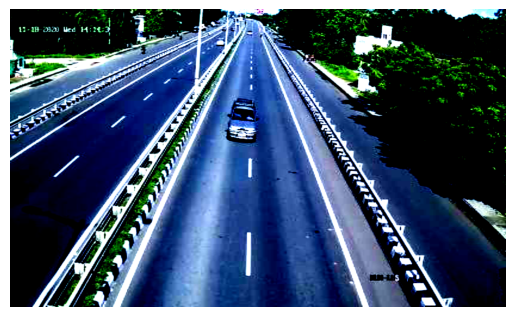

In [324]:
# Convert to [H, W, C] by permuting the dimensions
sample_data_np = sample_data.permute(1, 2, 0).to(device).numpy()
print(f"Shape: {sample_data_np.shape}")

# Plot the image
plt.imshow(sample_data_np)
plt.axis('off')  # Hide axis
plt.show()

We need to denormalized the test data to get original representation

In [379]:
image_mean = [0.485, 0.456, 0.406]
image_std = [0.229, 0.224, 0.225]

def de_normalize(n_img, mean, std):
    dtype, device = n_img.dtype, n_img.device
    mean = torch.as_tensor(mean, dtype=dtype, device=device)
    std = torch.as_tensor(std, dtype=dtype, device=device)
    # print(f"Shape of the normalized image: {n_img.shape}")
    dn_img = (n_img * std[:, None, None]) + mean[:, None, None]
    # print(f"Min value: {dn_img.min()}, Max value: {dn_img.max()}")
    # for visualization we can clamp the image values between 0 and 1 range 
    # dn_img = torch.clamp(dn_img, 0.0, 1.0)
    # for saving or using in API, we need to convert the image into uint8 [0,255] format
    dn_img = (dn_img * 255).byte()
    # print(f"Min value: {dn_img.min()}, Max value: {dn_img.max()}")

    return dn_img



In [378]:
dn_img = de_normalize(sample_data, image_mean, image_std) 
print(f"Shape after de normalize: {dn_img.shape}")
print(f"Type of de normalized image: {type(dn_img)}")

Shape of the normalized image: torch.Size([3, 600, 1000])
Min value: -2.9802322387695312e-08, Max value: 1.0000001192092896
Min value: 0, Max value: 255
Shape after de normalize: torch.Size([3, 600, 1000])
Type of de normalized image: <class 'torch.Tensor'>


Shape after converting to numpy: (600, 1000, 3)


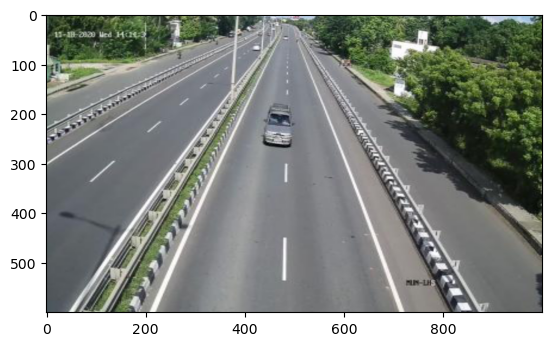

In [346]:
dn_img_np = dn_img.permute(1, 2, 0).to(device).numpy()
print(f"Shape after converting to numpy: {dn_img_np.shape}")

plt.imshow(dn_img_np)
plt.show()

In [347]:
# we will make a demo forward pass to get the prediction for this sample image
demo_input = sample_data.unsqueeze(0).to(device)
print(f"Shape of the demo input image after expanding its shape into batch size: {demo_input.shape}")

Shape of the demo input image after expanding its shape into batch size: torch.Size([1, 3, 600, 1000])


In [348]:
# forward pass
loaded_model.eval()
with torch.no_grad():
    predictions = loaded_model(demo_input)

In [352]:
# now we will see the prediction
print(f"The prediction is:\n {predictions}")

The prediction is:
 [{'boxes': tensor([[434.7593, 171.8895, 508.6583, 272.3270],
        [410.3617,  57.2531, 436.9327,  76.8633]]), 'labels': tensor([3, 3]), 'scores': tensor([0.9651, 0.1111])}]


In [350]:
# Process predictions
pred_boxes = predictions[0]["boxes"].to(device).numpy()  # Bounding boxes
pred_scores = predictions[0]["scores"].to(device).numpy()  # Confidence scores
pred_labels = predictions[0]["labels"].to(device).numpy()  # Labels

for box, score in zip(pred_boxes, pred_scores):
    if score > 0.5:  # Filter predictions by confidence threshold
        print(f"Score: {score}")
        print(f"Box: {box}")

Score: 0.9650593996047974
Box: [434.7593  171.88951 508.6583  272.32697]


In [357]:
type(dn_img_np)

numpy.ndarray

In [369]:
def draw_boxes_on_image(image, boxes, labels, scores, obj_to_idx, score_threshold=0.5):
    """
    Draw bounding boxes on the image with class labels and confidence scores.
    """
    # Convert the image to numpy if it is a PIL image
    if isinstance(image, Image.Image):
        image = np.array(image)

    # Ensure the image is in the correct format (BGR) and dtype
    if image.ndim == 2:  # Grayscale
        image = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
    elif image.ndim == 3 and image.shape[2] == 3:  # RGB
        image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)

    image = image.astype(np.uint8)

    for i in range(len(boxes)):
        if scores[i] > score_threshold:
            xmin, ymin, xmax, ymax = boxes[i]
            label_idx = labels[i]
            class_name = [key for key, value in obj_to_idx.items() if value == label_idx][0]

            # Draw the rectangle
            color = (0, 255, 0)
            thickness = 2
            cv2.rectangle(image, (int(xmin), int(ymin)), (int(xmax), int(ymax)), color, thickness)

            # Add label text
            label_text = f'{class_name}: {scores[i]:.2f}'
            font = cv2.FONT_HERSHEY_SIMPLEX
            font_scale = 0.5
            font_thickness = 2
            cv2.putText(image, label_text, (int(xmin), int(ymin)-10), font, font_scale, color, font_thickness)
    
    # converting back to the RGB format
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    return image


In [370]:
pred_img = draw_boxes_on_image(dn_img_np, pred_boxes, pred_labels, pred_scores, obj_to_idx, score_threshold=0.5)

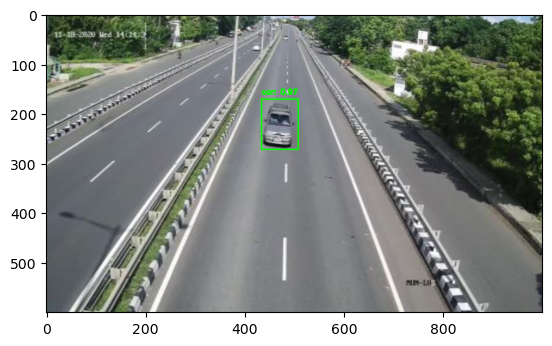

In [371]:
plt.imshow(pred_img)
plt.show()

In [387]:
# putting all together to get prediction from an image 
import time
def get_prediciton(img, img_mean, img_std, model, object_mapping, score_threshold=0.5):
    """
    This fucntion will achieve several tasks: 
        -> denormalize input image and convert it to the original format
        -> convert input image to batch size and pass through the model to get predicitons 
        -> these prediction values (boxes, score, labels) and original image will be sent
            to the another function that will generate the image with prediction bounding boxes
     Input:
          - img: sample image
          - img_mean: img mean value that was utilized during the training
          - img_std: img std values that was utilized during the training
          - model: trained model 
          - object_mapping: object to index mapping 
          - score_threshold: minimum probability considered while drawing the bounding boxes 
    Output:
          - pred_img: original image with predicted bounding boxes annotation
    """
    # define model as evaluation mode
    model.eval()
    
    # apply denormalization and convert into numpy to get original format
    dn_img = de_normalize(img, img_mean, img_std)
    np_img = dn_img.permute(1,2,0).to(device).numpy()
    # plt.imshow()

    # get prediction 
    start_time = time.time()
    img_input = img.unsqueeze(0).to(device)
    with torch.no_grad():
        predictions = model(img_input)
    
    # Process predictions
    pred_boxes = predictions[0]["boxes"].to(device).numpy()  # Bounding boxes
    pred_scores = predictions[0]["scores"].to(device).numpy()  # Confidence scores
    pred_labels = predictions[0]["labels"].to(device).numpy()  # Labels
    
    #inference time 
    inference_time = time.time() - start_time
    print(f"Inference time: {inference_time:.4f} seconds")
    
    # drawing predicted bounding boxes on the input image 
    pred_img = draw_boxes_on_image(np_img, pred_boxes, pred_labels, pred_scores, object_mapping, score_threshold=0.5)

    return pred_img
    

Inference time: 0.7740 seconds


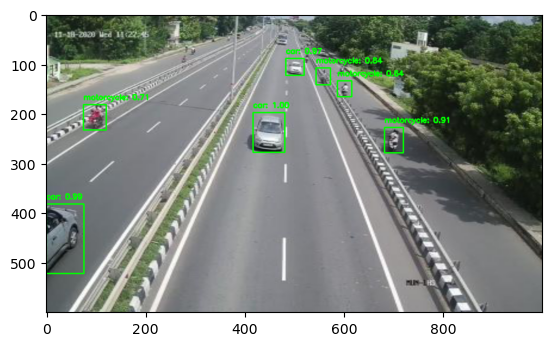

In [388]:
a = get_prediciton(test_data[132][0], image_mean, image_std, loaded_model, obj_to_idx, score_threshold=0.5)
plt.imshow(a)
plt.show()

In [389]:
# prediction with inference time
import time 

def prediction_with_time(img, img_mean, img_std, model, object_mapping, score_threshold=0.5):
    model.eval()
    
    # apply denormalization and convert into numpy to get original format
    dn_img = de_normalize(img, img_mean, img_std)
    np_img = dn_img.permute(1,2,0).to(device).numpy()
    
    start_time = time.time()
    img_input = img.unsqueeze(0).to(device)
    with torch.no_grad():
        predictions = model(img_input)
    
    # Process predictions
    pred_boxes = predictions[0]["boxes"].to(device).numpy()  # Bounding boxes
    pred_scores = predictions[0]["scores"].to(device).numpy()  # Confidence scores
    pred_labels = predictions[0]["labels"].to(device).numpy()  # Labels

    # Calculate the time taken for the prediction
    inference_time = time.time() - start_time
    
    annot_img = draw_boxes_on_image(np_img, pred_boxes, pred_labels, pred_scores, object_mapping, score_threshold=0.5)
    # Convert inference time to a string and add to the image
    inference_text = f"Inference time: {inference_time:.4f}s"
    font = cv2.FONT_HERSHEY_SIMPLEX
    
    # Adding the inference time text to the image in red color and positioned on the left
    cv2.putText(annot_img, inference_text, (10, 30), font, 0.7, (0, 0, 255), 2)  # Red color (0, 0, 255)

    # Display the annotated image
    plt.imshow(annot_img)
    plt.show()
    

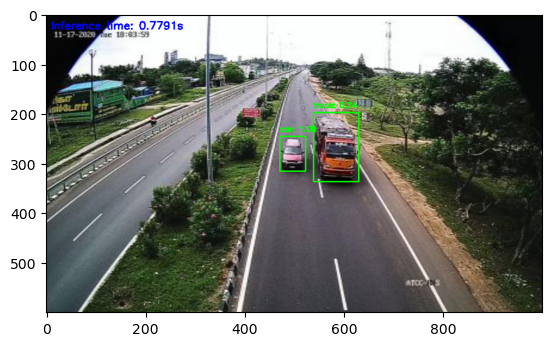

In [391]:
prediction_with_time(test_data[153][0], image_mean, image_std, loaded_model, obj_to_idx, score_threshold=0.5)

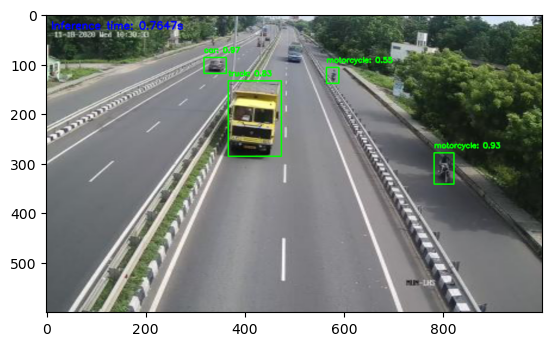

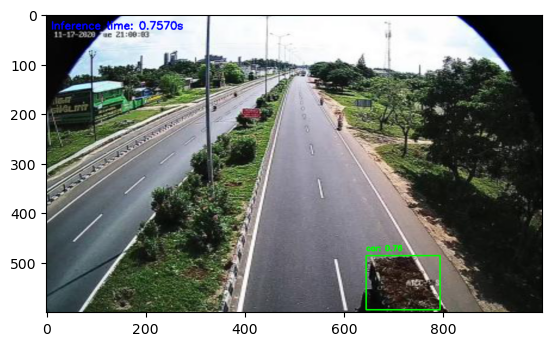

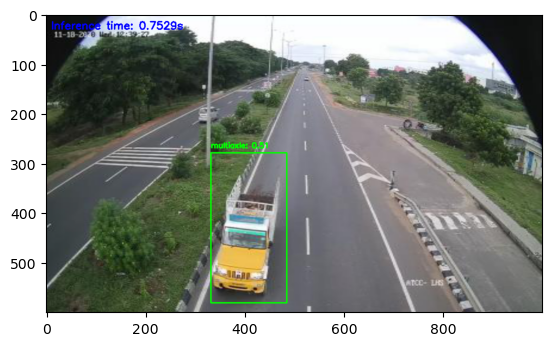

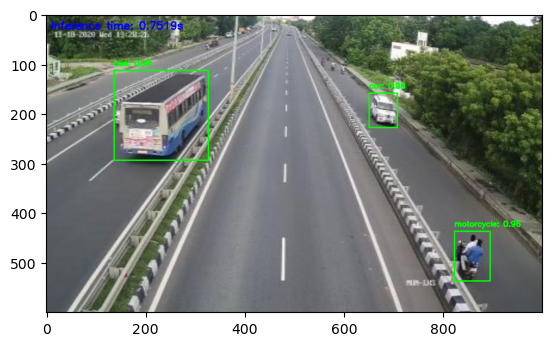

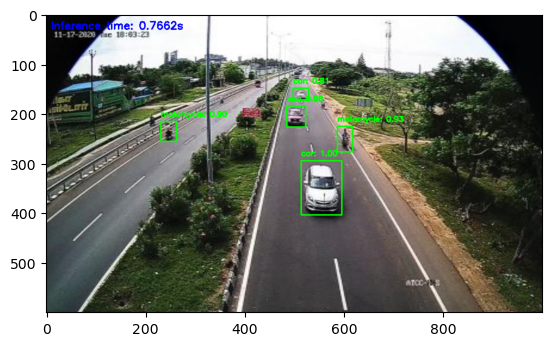

...

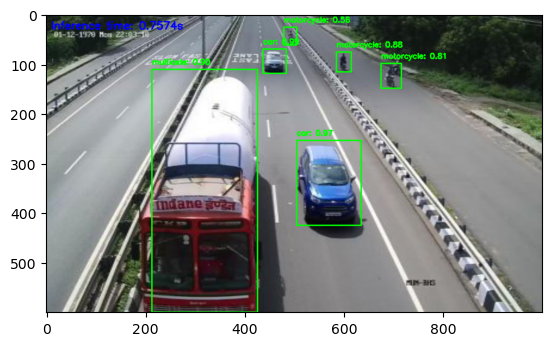

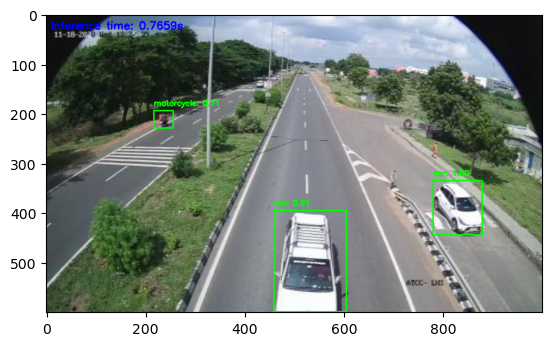

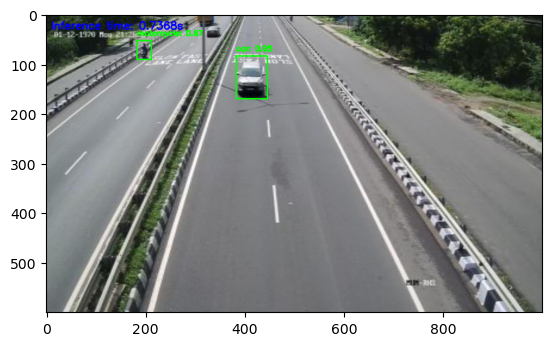

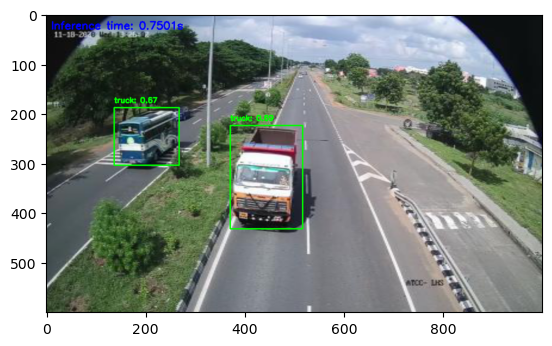

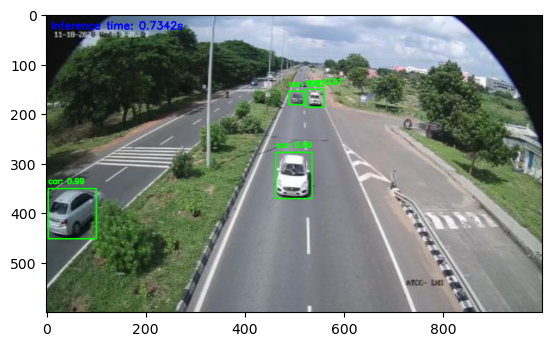

In [395]:
# now we will test our model with test data
for i in range(0, len(test_data), 20):
    prediction_with_time(test_data[i][0], image_mean, image_std, loaded_model, obj_to_idx, score_threshold=0.5)

#### Evaluation

In [426]:
# function to get IoU
def get_iou_eval(det_box, gt_box):
    """
    det_box: detected box
    gt_box: ground truth box
    """
    det_box_x1, det_box_y1, det_box_x2, det_box_y2 = det_box
    gt_box_x1, gt_box_y1, gt_box_x2, gt_box_y2 = gt_box

    x_left = max(det_box_x1, gt_box_x1)
    y_top = max(det_box_y1, gt_box_y1)
    x_right = min(det_box_x2, gt_box_x2)
    y_bottom = min(det_box_y2, gt_box_y2)

    if x_right < x_left or y_bottom < y_top:
        return 0.0 

    # calculate area of intersection 
    area_intersection = (x_right - x_left) * (y_bottom - y_top)
    det_box_area = (det_box_x2 - det_box_x1) * (det_box_y2 - det_box_y1)
    gt_box_area = (gt_box_x2 - gt_box_x1) * (gt_box_y2 - gt_box_y1)
    area_union = float(det_box_area + gt_box_area - area_intersection + 1E-6)
    iou = area_intersection / area_union
    return iou

In [427]:
# FUNCTION TO COMPUTE mAP
def compute_map(pred_boxes, gt_boxes, iou_threshold=0.5, method="area"):
    """
    This function takes predicted boxes and ground truth boxes to calculate the
    mean average precision score.
    :pred_boxes -> predicted boxes for detection by model  
    :gt_boxes -> ground truth boxes 
    pred_boxes = [
    {
        'person': [[x1, y1, x2, y2, score], ...],
        'car': [[x1, y1, x2, y2, score], ...]
    }
    {pred_boxes_img_2},
    ...
    {pred_boxes_img_N}
    ]

    gt_boxes = [
    {
        'person': [[x1, y1, x2, y2], ...],
        'car': [[x1, y1, x2, y2], ...]
    }
    {gt_boxes_img_2},
    ...
    {gt_boxes_img_N}
    ]
    """
    gt_labels = {cls_key for im_gt in gt_boxes for cls_key in im_gt.keys()}
    gt_labels = sorted(gt_labels)
    all_aps = {} 
    # average precision for all classes 
    aps = []
    for idx, label in enumerate(gt_labels):
        cls_preds = [
            [im_idx, im_preds_label] for im_idx, im_preds in enumerate(pred_boxes)
            if label in im_preds for im_preds_label in im_preds[label]
        ]
        # cls_preds = [
        # (0, [x1_0, y1_0, x2_0, y2_0, score_0])
        # ....
        # (1, [x1_N, y1_N, x2_N, y2_N, score_N])
        # ]
        
        # sort the prediction boxes by confidence scores 
        cls_preds = sorted(cls_preds, key=lambda k: -k[1][-1])
    
        # tracking matached gt boxes of this class 
        gt_matched = [[False for _ in img_gts[label]] for img_gts in gt_boxes]
        # number of gt boxes for this class for recall calculation
        num_gts = sum([len(img_gts[label]) for img_gts in gt_boxes])
        tp = [0] * len(cls_preds)
        fp = [0] * len(cls_preds)

        # for each prediction
        for pred_idx, (im_idx, det_pred) in enumerate(cls_preds):
            # get gt boxes for this image and this label 
            img_gts = gt_boxes[im_idx][label]
            max_iou_found = -1
            max_iou_gt_idx = -1

            # get best matching bounding box 
            for gt_box_idx, gt_box in enumerate(img_gts):
                gt_box_iou = get_iou_eval(det_pred[:-1], gt_box)
                if gt_box_iou > max_iou_found:
                    max_iou_found = gt_box_iou
                    max_iou_gt_idx = gt_box_idx
            # TP only if iou>= threshold and this gt has not yet been matched 
            if max_iou_found < iou_threshold or gt_matched[im_idx][max_iou_gt_idx]:
                fp[pred_idx] = 1
            else:
                tp[pred_idx] = 1
        # cumulative tp and fp
        tp = np.cumsum(tp)
        fp = np.cumsum(fp)

        eps = np.finfo(np.float32).eps
        recalls = tp / np.maximum(num_gts, eps)
        precisions = tp / np.maximum((tp + fp), eps)

        if method == "area":
            recalls = np.concatenate(([0.0], recalls, [1.0]))
            precisions = np.concatenate(([0.0], precisions, [0.0]))

            # Replace precision values with recall r with maximum precision value 
            # of only recall value >= r
            # This computes the precision envelpoe
            for i in range(precisions.size -1, 0, -1):
                precisions[i-1] = np.maximum(precisions[i-1], precisions[i])
            # for computing area, get points where recall changes value
            i = np.where(recalls[1:] != recalls[:-1])[0]
            # Add the rectangular areas to get ap 
            ap = np.sum((recalls[i+1] - recalls[i]) * precisions[i+1])
        elif method == "interp":
            ap = 0.0
            for interp_pt in np.arange(0, 1+1E-3, 0.1):
                # get precision values for recall values 
                prec_interp_pt = precisions[recalls >= interp_pt]
                # get maximum of those precision values 
                prec_interp_pt = prec_interp_pt.max() if prec_interp_pt.size > 0.0 else 0.0
                ap += prec_interp_pt
            ap = ap / 11.00
        else:
            raise ValueError('Method can only be area or interp')
        if num_gts > 0:
            aps.append(ap)
            all_aps[label] = ap
        else:
            all_aps[label] = np.nan
        
    # compute mAP at provided iou threshold 
    mean_ap = sum(aps) / len(aps)
    return mean_ap, all_aps

In [428]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [433]:
import math
# evalutiion with valid loader 
loaded_model.to(device)
loaded_model.eval()
gts = []
preds = []

for im, target, f_name in tqdm(test_loader):
    # im_name = f_name
    torch.cuda.empty_cache()
    im = im.float().to(device)

    for target in targets:
        # print("The target: ",target)
         # Rename 'bboxes' to 'boxes', convert to float, and move to device
        target["boxes"] = target.pop("boxes").float().to(device)
        target['labels'] = target['labels'].long().to(device)  # Convert labels to tensor and move to device
    
    with torch.no_grad():  # Disable gradient calculations for evaluation
        output = loaded_model(im, None)

    boxes = output[0]['boxes']
    labels = output[0]['labels']
    scores = output[0]['scores']

    pred_boxes = {}
    gt_boxes = {}

    for label_name in obj_to_idx:
        pred_boxes[label_name] = []
        gt_boxes[label_name] = []
    
    for idx, box in enumerate(boxes):
        if device=='cuda':
            x1, y1, x2, y2 = box.detach().cpu().numpy()
            label = labels[idx].detach().cpu().item()
            score = scores[idx].detach().cpu().item()
        else:
            # print(f"From the prediction: {box}")
            x1, y1, x2, y2 = box
            label = labels[idx].item()
            score = scores[idx].item()
        label_name = idx_to_obj[label]
        pred_boxes[label_name].append([x1, y1, x2, y2, score])

    for idx, box in enumerate(targets[0]['boxes']):
        # print(f"The targets: {targets}")
        if device=='cuda':
            x1, y1, x2, y2 = box.detach().cpu().numpy()
            label = targets[0]['labels'][idx].detach().cpu().item()
        else:
            # print(f"From the target: {box}")
            x1, y1, x2, y2 = box
            label =  targets[0]['labels'][idx].item()
        label_name = idx_to_obj[label]
        gt_boxes[label_name].append([x1, y1, x2, y2])

    gts.append(gt_boxes)
    preds.append(pred_boxes)

  9%|▉         | 27/308 [00:12<02:06,  2.22it/s]

Skipping image vehicle-detection/vehicle-test/image_07509.jpg with no bounding boxes.


 22%|██▏       | 67/308 [00:30<01:47,  2.23it/s]

Skipping image vehicle-detection/vehicle-test/image_07875.jpg with no bounding boxes.


 46%|████▌     | 141/308 [01:03<01:15,  2.20it/s]

Skipping image vehicle-detection/vehicle-test/image_08116.jpg with no bounding boxes.


100%|██████████| 308/308 [02:18<00:00,  2.22it/s]


In [434]:
print(f"Total ground truth values: {len(gts)}")
print(f"Total predicted values: {len(preds)}")

Total ground truth values: 308
Total predicted values: 308


In [435]:
preds[1]

{'background': [],
 'auto': [],
 'bus': [[tensor(247.1230, device='cuda:0'),
   tensor(265.4894, device='cuda:0'),
   tensor(425.8911, device='cuda:0'),
   tensor(587.2452, device='cuda:0'),
   0.3856619894504547],
  [tensor(98.6985, device='cuda:0'),
   tensor(190.8833, device='cuda:0'),
   tensor(391.5453, device='cuda:0'),
   tensor(586.0013, device='cuda:0'),
   0.0607539527118206]],
 'car': [[tensor(246.7404, device='cuda:0'),
   tensor(269.3224, device='cuda:0'),
   tensor(431.0112, device='cuda:0'),
   tensor(595.9699, device='cuda:0'),
   0.16049179434776306]],
 'lcv': [[tensor(239.0350, device='cuda:0'),
   tensor(274.9095, device='cuda:0'),
   tensor(429.4965, device='cuda:0'),
   tensor(582.9827, device='cuda:0'),
   0.23126137256622314]],
 'motorcycle': [[tensor(595.8264, device='cuda:0'),
   tensor(94.3418, device='cuda:0'),
   tensor(628.9962, device='cuda:0'),
   tensor(143.6718, device='cuda:0'),
   0.9594152569770813],
  [tensor(635.1983, device='cuda:0'),
   tensor(68

In [445]:
# getting mean average precision and all average precision scores 
# mean_ap, all_aps = compute_map(preds, gts, method='interp') 

mean_ap, all_aps = compute_map(preds, gts, iou_threshold=0.25, method="interp") 

In [446]:
mean_ap

0.04706285131928852

In [447]:
print(f"Class Wise Average Precision==>")
for idx in range(len(idx_to_obj)):
    class_name = idx_to_obj[idx]  # Get the class name
    if class_name in all_aps:
        ap = all_aps[class_name]
        print('AP for class {} = {:.4f}'.format(class_name, ap))
    else:
        print('AP for class {} = NaN (no ground truth)'.format(class_name))
print(f"Mean Average Precision (mAP): {mean_ap:.4f}")


Class Wise Average Precision==>
AP for class background = nan
AP for class auto = 0.0028
AP for class bus = 0.0909
AP for class car = 0.0909
AP for class lcv = nan
AP for class motorcycle = 0.0037
AP for class multiaxle = nan
AP for class tractor = nan
AP for class truck = nan
Mean Average Precision (mAP): 0.0471
